# Исследование объявлений о продаже квартир от Яндекс.Недвижимость 

Для построения автоматизированной системы по поиску аномалии и мошеннической деятельности необходимо научиться определять рыночную стоимость объектов, для  чего необходимо провести исследовательский данных от сервиса Яндекс.Недвижимость. 

## Загрузка библиотек и данных 

In [1]:
import pandas as pd
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import os

In [2]:
try:
    path = '/datasets/real_estate_data.csv'
    data = pd.read_csv(path, sep = '\t')

except FileNotFoundError:
    current_directory = os.getcwd()
    data = pd.read_csv(current_directory + path, sep = '\t')

display(data.head())

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
0,20,13000000.0,108.0,2019-03-07T00:00:00,3,2.70,16.0,51.0,8,NaN,...,25.0,NaN,Санкт-Петербург,18863.0,16028.0,1.0,482.0,2.0,755.0,NaN
1,7,3350000.0,40.4,2018-12-04T00:00:00,1,NaN,11.0,18.6,1,NaN,...,11.0,2.0,посёлок Шушары,12817.0,18603.0,0.0,NaN,0.0,NaN,81.0
2,10,5196000.0,56.0,2015-08-20T00:00:00,2,NaN,5.0,34.3,4,NaN,...,8.3,0.0,Санкт-Петербург,21741.0,13933.0,1.0,90.0,2.0,574.0,558.0
3,0,64900000.0,159.0,2015-07-24T00:00:00,3,NaN,14.0,NaN,9,NaN,...,NaN,0.0,Санкт-Петербург,28098.0,6800.0,2.0,84.0,3.0,234.0,424.0
4,2,10000000.0,100.0,2018-06-19T00:00:00,2,3.03,14.0,32.0,13,NaN,...,41.0,NaN,Санкт-Петербург,31856.0,8098.0,2.0,112.0,1.0,48.0,121.0


In [3]:
# Общая информация о столбцах датасета
display(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23699 entries, 0 to 23698
Data columns (total 22 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   total_images          23699 non-null  int64  
 1   last_price            23699 non-null  float64
 2   total_area            23699 non-null  float64
 3   first_day_exposition  23699 non-null  object 
 4   rooms                 23699 non-null  int64  
 5   ceiling_height        14504 non-null  float64
 6   floors_total          23613 non-null  float64
 7   living_area           21796 non-null  float64
 8   floor                 23699 non-null  int64  
 9   is_apartment          2775 non-null   object 
 10  studio                23699 non-null  bool   
 11  open_plan             23699 non-null  bool   
 12  kitchen_area          21421 non-null  float64
 13  balcony               12180 non-null  float64
 14  locality_name         23650 non-null  object 
 15  airports_nearest   

None

array([[<Axes: title={'center': 'total_images'}>,
        <Axes: title={'center': 'last_price'}>,
        <Axes: title={'center': 'total_area'}>,
        <Axes: title={'center': 'rooms'}>],
       [<Axes: title={'center': 'ceiling_height'}>,
        <Axes: title={'center': 'floors_total'}>,
        <Axes: title={'center': 'living_area'}>,
        <Axes: title={'center': 'floor'}>],
       [<Axes: title={'center': 'kitchen_area'}>,
        <Axes: title={'center': 'balcony'}>,
        <Axes: title={'center': 'airports_nearest'}>,
        <Axes: title={'center': 'cityCenters_nearest'}>],
       [<Axes: title={'center': 'parks_around3000'}>,
        <Axes: title={'center': 'parks_nearest'}>,
        <Axes: title={'center': 'ponds_around3000'}>,
        <Axes: title={'center': 'ponds_nearest'}>],
       [<Axes: title={'center': 'days_exposition'}>, <Axes: >, <Axes: >,
        <Axes: >]], dtype=object)

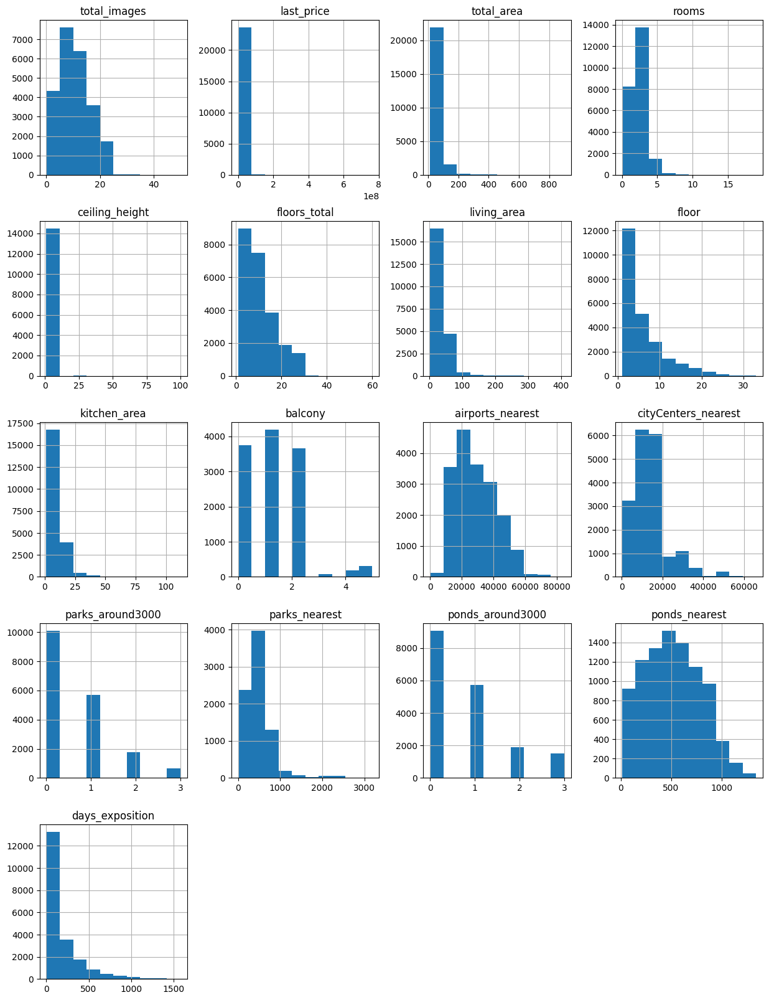

In [4]:
# Гистограммы распределения значений столбцов
data.hist(figsize=(15, 20))

Датасет содержит 23699 записей об объявлениях о продаже квартир. В датасете 28 столбцов с данными различных типов, включая цену, дату публикации, площадь, населенный пункт и прочее. В датасете присутствуют пропуски в некоторых стобцах.

## Предобработка данных

In [5]:
# Подсчет NaN значений в столбцах
nan_count = data.isna().sum()
print(nan_count)

total_images                0
last_price                  0
total_area                  0
first_day_exposition        0
rooms                       0
ceiling_height           9195
floors_total               86
living_area              1903
floor                       0
is_apartment            20924
studio                      0
open_plan                   0
kitchen_area             2278
balcony                 11519
locality_name              49
airports_nearest         5542
cityCenters_nearest      5519
parks_around3000         5518
parks_nearest           15620
ponds_around3000         5518
ponds_nearest           14589
days_exposition          3181
dtype: int64


In [6]:
# Анализ и предобработка столбца 'is_apartment'
print(data['is_apartment'].unique())
data['is_apartment'].fillna(0, inplace = True)
data['is_apartment'].unique()
data['is_apartment'] = data['is_apartment'].astype(int)
print(data['is_apartment'].unique())

[nan False True]
[0 1]


/var/folders/2r/zfmtb66x3rs14ctpbj7lhdt40000gp/T/ipykernel_19263/3739064221.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data['is_apartment'].fillna(0, inplace = True)


В столбце is_apartment обнаружено большое количество NaN значений. Вероятнее всего, в данном случае NaN равносильно False, поскольку большинство квартир обычно не являются апартаментами. 

In [7]:
# Анализ и предобработка столбца 'balcony'
print(data['balcony'].unique())
data['balcony'].fillna(0, inplace = True)
data['balcony'] = data['balcony'].astype(int)
print(data['balcony'].unique())

[nan  2.  0.  1.  5.  4.  3.]
[0 2 1 5 4 3]


/var/folders/2r/zfmtb66x3rs14ctpbj7lhdt40000gp/T/ipykernel_19263/910076352.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  data['balcony'].fillna(0, inplace = True)


В столбце balcony обнаружено большое количество NaN значений. Вероятнее всего, в данном случае NaN равносильно отсутствию балкона. 

In [8]:
# Перевод bool столбцов в int для дальнейшего удобства работы
for col in data.columns:
    if data[col].dtype == bool:
        data[col] = data[col].astype(int)


In [9]:
# Обработка столбца населенных пунктов

# функция определения схожести строк
def jaccard_similarity(str1, str2):
    set1 = set(str1)
    set2 = set(str2)
    intersection = len(set1.intersection(set2))
    union = len(set1) + len(set2) - intersection
    return intersection / union

print('Список посимвольно схожих наименований, выявленных функцией:')
# вывод похожих строк, сдвинул порог похожести в условии для коротких названий
for name1 in data['locality_name'].dropna().unique():
    for name2 in data['locality_name'].dropna().unique():
        similarity = jaccard_similarity(name1, name2)
        if (similarity >= (len(name1) - 3)/len(name1)) and (name1 != name2):
            print(name1, ' = ', name2)
            
# исправление самого частого неявного дубликата
data['locality_name'] = data['locality_name'].str.replace('поселок', 'посёлок')
print()


print('Список неполных и соответствующих им полных названий:')
# остатки отсмотрел и исправил вручную, т.к. использованная фукнция схожести плохо работает с короткими названиями
for name1 in data['locality_name'].dropna().unique():
    for name2 in data['locality_name'].dropna().unique():
        if (name1 in name2) and (name1 != name2):
            print(name1, ' = ', name2)

            
data['locality_name'] = data['locality_name'].replace('Кудрово', 'деревня Кудрово')
data['locality_name'] = data['locality_name'].replace('городской посёлок Советский', 'посёлок городского типа Советский')
data['locality_name'] = data['locality_name'].replace('Любань', 'посёлок Любань')
data['locality_name'] = data['locality_name'].replace('посёлок Лесное', 'коттеджный посёлок Лесное')
data['locality_name'] = data['locality_name'].replace('Мурино', 'посёлок Мурино')
data['locality_name'] = data['locality_name'].replace('Никольское', 'село Никольское')

print()
print('Финальный список уникальных населенных пунктов:')
for word in sorted(data['locality_name'].dropna().unique()):
    print(word)




Список посимвольно схожих наименований, выявленных функцией:
городской посёлок Янино-1  =  городской поселок Янино-1
посёлок Парголово  =  городской посёлок Павлово
посёлок Мурино  =  поселок Мурино
посёлок Мурино  =  посёлок Мичуринское
посёлок Мурино  =  поселок Мичуринское
поселок Мурино  =  посёлок Мурино
поселок Мурино  =  посёлок Мичуринское
поселок Мурино  =  поселок Мичуринское
посёлок городского типа Лебяжье  =  поселок городского типа Лебяжье
посёлок городского типа Сиверский  =  поселок городского типа Советский
посёлок городского типа Сиверский  =  городской посёлок Советский
Павловск  =  село Павлово
Павловск  =  Пикалёво
деревня Пикколово  =  деревня Пеники
Волхов  =  Волосово
Приозерск  =  Приморск
Сестрорецк  =  Светогорск
посёлок Аннино  =  поселок Аннино
посёлок Плодовое  =  посёлок Перово
посёлок Плодовое  =  посёлок Плоское
поселок Торковичи  =  поселок Терволово
посёлок Новый Свет  =  поселок Новый Свет
Мурино  =  посёлок Мурино
Мурино  =  поселок Мурино
Никольское

В столбце locality_name обнаружено несколько неявных дубликатов в связи с заменой буквы ё на е и разными наименованиями для одних и тех же населенных пунктов. 

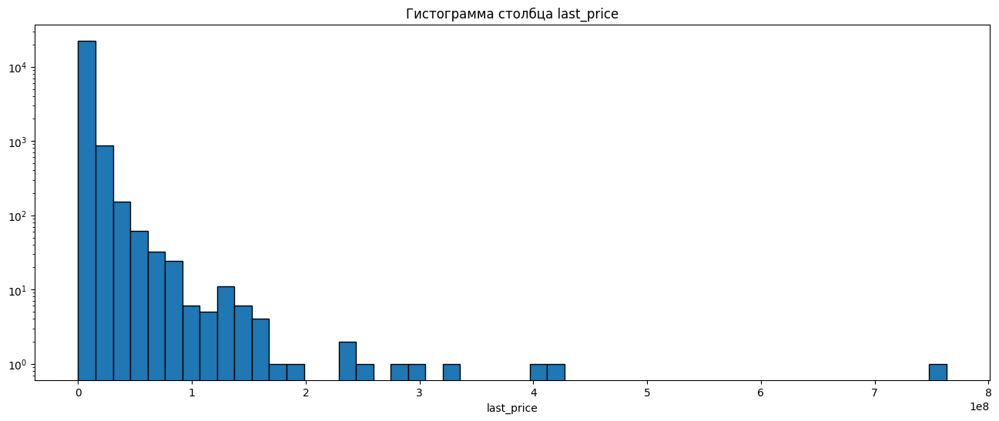

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
12971,19,763000000.0,400.0,2017-09-30T00:00:00,7,NaN,10.0,250.0,10,0,...,NaN,2,Санкт-Петербург,25108.0,3956.0,1.0,530.0,3.0,756.0,33.0
19540,8,420000000.0,900.0,2017-12-06T00:00:00,12,2.80,25.0,409.7,25,0,...,112.0,0,Санкт-Петербург,30706.0,7877.0,0.0,NaN,2.0,318.0,106.0
14706,15,401300000.0,401.0,2016-02-20T00:00:00,5,NaN,9.0,204.0,9,0,...,24.0,3,Санкт-Петербург,21912.0,2389.0,1.0,545.0,1.0,478.0,393.0
1436,19,330000000.0,190.0,2018-04-04T00:00:00,3,3.50,7.0,95.0,5,0,...,40.0,0,Санкт-Петербург,23011.0,1197.0,3.0,519.0,3.0,285.0,233.0
15651,20,300000000.0,618.0,2017-12-18T00:00:00,7,3.40,7.0,258.0,5,0,...,70.0,0,Санкт-Петербург,32440.0,5297.0,0.0,NaN,2.0,198.0,111.0
22831,18,289238400.0,187.5,2019-03-19T00:00:00,2,3.37,6.0,63.7,6,0,...,30.2,0,Санкт-Петербург,22494.0,1073.0,3.0,386.0,3.0,188.0,NaN
16461,17,245000000.0,285.7,2017-04-10T00:00:00,6,3.35,7.0,182.8,4,0,...,29.8,0,Санкт-Петербург,33143.0,6235.0,3.0,400.0,3.0,140.0,249.0
13749,7,240000000.0,410.0,2017-04-01T00:00:00,6,3.40,7.0,218.0,7,0,...,40.0,0,Санкт-Петербург,32440.0,5297.0,0.0,NaN,2.0,198.0,199.0
5893,3,230000000.0,500.0,2017-05-31T00:00:00,6,NaN,7.0,NaN,7,0,...,40.0,0,Санкт-Петербург,32440.0,5297.0,0.0,NaN,2.0,198.0,50.0
8900,13,190870000.0,268.0,2016-03-25T00:00:00,3,NaN,8.0,132.0,7,0,...,40.0,0,Санкт-Петербург,32440.0,5297.0,0.0,NaN,2.0,198.0,901.0


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
8793,7,12190.0,109.0,2019-03-20T00:00:00,2,2.75,25.0,32.0,25,0,...,40.5,0,Санкт-Петербург,36421.0,9176.0,1.0,805.0,0.0,NaN,8.0
14911,5,430000.0,54.0,2018-06-26T00:00:00,2,NaN,3.0,NaN,3,0,...,NaN,0,посёлок станции Свирь,NaN,NaN,NaN,NaN,NaN,NaN,44.0
17456,7,430000.0,30.4,2019-04-22T00:00:00,1,NaN,2.0,16.0,1,0,...,6.0,0,Сланцы,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16274,18,440000.0,40.0,2018-07-10T00:00:00,1,NaN,5.0,NaN,1,0,...,NaN,0,деревня Старополье,NaN,NaN,NaN,NaN,NaN,NaN,45.0
9581,7,450000.0,43.4,2018-08-31T00:00:00,2,NaN,5.0,30.3,3,0,...,5.5,0,деревня Старополье,NaN,NaN,NaN,NaN,NaN,NaN,96.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1781,9,990000.0,34.0,2016-05-31T00:00:00,2,NaN,2.0,26.0,2,0,...,8.0,1,Луга,NaN,NaN,NaN,NaN,NaN,NaN,78.0
14341,8,990000.0,28.0,2018-01-04T00:00:00,1,NaN,2.0,18.0,1,0,...,9.0,0,посёлок городского типа Вырица,NaN,NaN,NaN,NaN,NaN,NaN,NaN
13420,3,995000.0,31.5,2015-05-13T00:00:00,1,NaN,5.0,17.0,2,0,...,5.8,2,деревня Извара,NaN,NaN,NaN,NaN,NaN,NaN,757.0
1761,11,999000.0,62.0,2018-02-15T00:00:00,4,NaN,5.0,46.0,2,0,...,7.0,0,Бокситогорск,NaN,NaN,NaN,NaN,NaN,NaN,226.0


In [10]:
# Анализ и обработка столбца last_price
plt.figure(figsize=(16, 6))
plt.hist(data['last_price'], bins=50, edgecolor='black', log=True)
plt.xlabel('last_price')
plt.title('Гистограмма столбца last_price')
plt.show()

# Поиск выбросов в ценах
display(data[data['last_price'] > data['last_price'].median()*30].sort_values(by = 'last_price', ascending = False))

# Поиск выбросов в ценах
display(data[data['last_price'] < 1000000].sort_values(by = 'last_price'))


In [11]:
# Замена выброса на наиболее вероятное значение
data.loc[data['last_price'] == 12190, 'last_price'] = 12190000

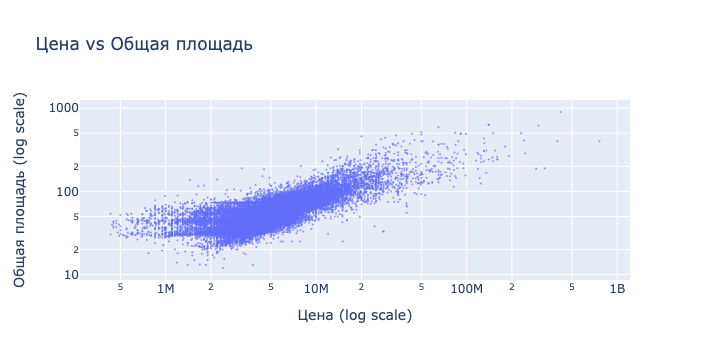

In [12]:
# Scatter график Цена vs Общая площадь

fig = go.Figure()

fig.add_trace(go.Scatter(x=data['last_price'], 
                         y=data['total_area'], 
                         mode='markers', 
                         marker=dict(
                         size=2,
                         opacity=0.7  
    )))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')
fig.update_layout(
    title='Цена vs Общая площадь',
    xaxis_title='Цена (log scale)',
    yaxis_title='Общая площадь (log scale)'
)
fig.show()


В столбце last_price была обнаружена и исправлена аномалия, связанная с опечаткой. 

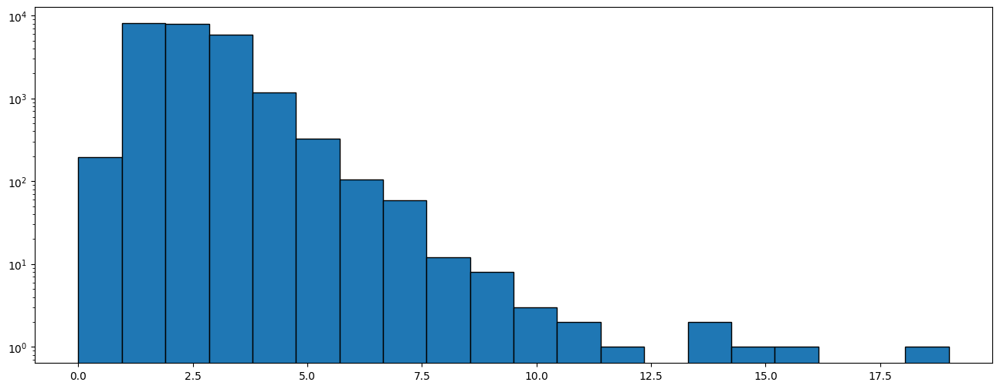

In [13]:
# Поиск выбросов в количестве комнат
plt.figure(figsize=(16, 6))
plt.hist(data['rooms'], bins=20, edgecolor='black', log=True)
plt.show()

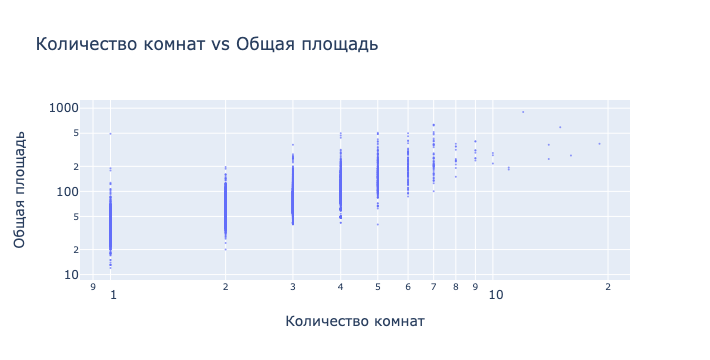

In [14]:
# Scatter график Количество комнат vs Общая площадь
fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['rooms'], 
    y=data['total_area'], 
    mode='markers', 
    marker=dict(size=2,opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')
fig.update_layout(
    title='Количество комнат vs Общая площадь',
    xaxis_title='Количество комнат',
    yaxis_title='Общая площадь'
)

fig.show()

В столбце rooms присутствуют значения, которые выглядят аномально (однокомнатныу квартиры площадью более 200 метров), тем не менее, оставим их как есть. 

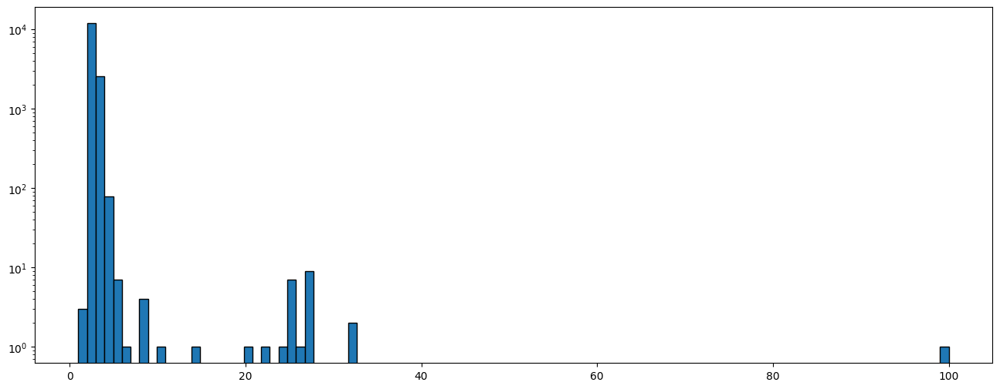

In [15]:
# Поиск выбросов в высоте потолков
plt.figure(figsize=(16, 6))
plt.hist(data['ceiling_height'], bins=100, edgecolor='black', log=True)
plt.show()

In [16]:
# Выявляю значения самых высоких и низких потолков
display(data[data['ceiling_height'] > data['ceiling_height'].median()*2].sort_values(by = 'ceiling_height', ascending = False)) 
display(data[data['ceiling_height'] < data['ceiling_height'].median()].sort_values(by = 'ceiling_height'))

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
22869,0,15000000.0,25.0,2018-07-25T00:00:00,1,100.0,5.0,14.0,5,1,...,11.0,5,Санкт-Петербург,34963.0,8283.0,1.0,223.0,3.0,30.0,19.0
3148,14,2900000.0,75.0,2018-11-12T00:00:00,3,32.0,3.0,53.0,2,0,...,8.0,0,Волхов,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22336,19,9999000.0,92.4,2019-04-05T00:00:00,2,32.0,6.0,55.5,5,0,...,16.5,4,Санкт-Петербург,18838.0,3506.0,0.0,NaN,3.0,511.0,NaN
21377,19,4900000.0,42.0,2017-04-18T00:00:00,1,27.5,24.0,37.7,19,0,...,11.0,2,Санкт-Петербург,42742.0,9760.0,0.0,NaN,0.0,NaN,61.0
22938,14,4000000.0,98.0,2018-03-15T00:00:00,4,27.0,2.0,73.0,2,1,...,9.0,1,деревня Нижняя,NaN,NaN,NaN,NaN,NaN,NaN,27.0
4876,7,3000000.0,25.0,2017-09-27T00:00:00,0,27.0,25.0,17.0,17,0,...,NaN,2,посёлок Мурино,NaN,NaN,NaN,NaN,NaN,NaN,28.0
21824,20,2450000.0,44.0,2019-02-12T00:00:00,2,27.0,2.0,38.0,2,0,...,8.6,2,городской посёлок Большая Ижора,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5246,0,2500000.0,54.0,2017-10-13T00:00:00,2,27.0,5.0,30.0,3,0,...,9.0,2,деревня Мины,NaN,NaN,NaN,NaN,NaN,NaN,540.0
5807,17,8150000.0,80.0,2019-01-09T00:00:00,2,27.0,36.0,41.0,13,0,...,12.0,5,Санкт-Петербург,18732.0,20444.0,0.0,NaN,3.0,80.0,38.0
20478,11,8000000.0,45.0,2017-07-18T00:00:00,1,27.0,4.0,22.0,2,0,...,10.0,1,Санкт-Петербург,18975.0,3246.0,0.0,NaN,3.0,449.0,429.0


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
22590,16,6000000.0,55.00,2018-10-31T00:00:00,2,1.00,12.0,32.40,7,0,...,10.00,0,Санкт-Петербург,33053.0,14217.0,2.0,293.0,2.0,289.0,13.0
5712,5,1500000.0,42.80,2017-08-14T00:00:00,2,1.20,2.0,27.50,1,0,...,5.20,0,городской посёлок Мга,NaN,NaN,NaN,NaN,NaN,NaN,248.0
16934,5,4100000.0,40.00,2017-10-17T00:00:00,1,1.75,37.0,17.40,5,0,...,8.34,0,Санкт-Петербург,18732.0,20444.0,0.0,NaN,3.0,80.0,71.0
2572,4,2400000.0,62.00,2018-12-27T00:00:00,3,2.00,5.0,40.00,4,0,...,6.00,1,Луга,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5850,9,1650000.0,35.50,2018-05-29T00:00:00,1,2.00,5.0,NaN,5,0,...,NaN,0,Луга,NaN,NaN,NaN,NaN,NaN,NaN,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
696,1,3364930.0,34.69,2014-11-27T00:00:00,1,2.64,25.0,23.43,25,0,...,23.43,2,Санкт-Петербург,43396.0,12153.0,0.0,NaN,0.0,NaN,574.0
665,2,3720000.0,34.09,2018-07-16T00:00:00,1,2.64,18.0,15.90,13,0,...,10.59,2,Санкт-Петербург,17755.0,16576.0,0.0,NaN,1.0,594.0,115.0
3089,18,8000000.0,68.00,2019-04-22T00:00:00,3,2.64,12.0,44.00,3,0,...,8.00,0,Санкт-Петербург,35620.0,9913.0,1.0,91.0,1.0,819.0,NaN
4518,8,3900000.0,38.60,2017-07-20T00:00:00,1,2.64,18.0,20.00,14,0,...,10.60,0,Санкт-Петербург,33058.0,14156.0,0.0,NaN,1.0,935.0,23.0


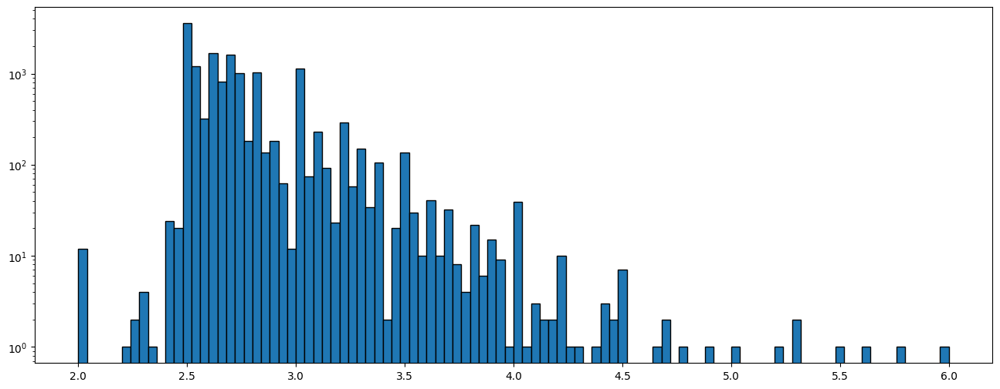

In [17]:
# Потолки от 20 до 32 метров метров выглядят как опечатка на порядок, исправляю
# Потолки от 8 до 14 метров, 100 метров и ниже 2 метров заменяю на медианные значения

data.loc[data['ceiling_height'] == 100, 'ceiling_height'] = pd.NA
data.loc[data['ceiling_height'] >= 20, 'ceiling_height']/=10
data.loc[(data['ceiling_height'] <=14) & (data['ceiling_height'] >= 8), 'ceiling_height'] = pd.NA 
data.loc[data['ceiling_height'] < 2, 'ceiling_height'] = pd.NA

data['ceiling_height'] = pd.to_numeric(data['ceiling_height'], errors = 'coerce')

# Проверяю обновленные данные
plt.figure(figsize=(16, 6))
plt.hist(data['ceiling_height'], bins=100, edgecolor='black', log=True)
plt.show()

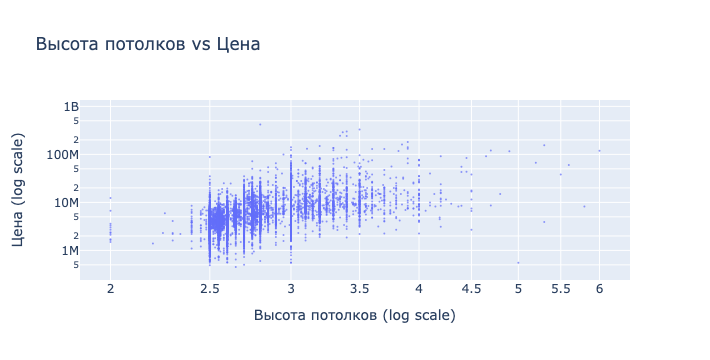

In [18]:
# Scatter график Высота потолков vs Цена

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['ceiling_height'], 
    y=data['last_price'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')

# Update layout
fig.update_layout(
    title='Высота потолков vs Цена',
    xaxis_title='Высота потолков (log scale)',
    yaxis_title='Цена (log scale)'
)

# Show the plot
fig.show()

В столбце ceiling_height обнаружены аномалии, связанные и не связанные с опечатками. Опечатки были исправлены, прочие аномальные значения принадлежат квартирам со средней стоимостью и заменены на медианные значения высоты потолков. 

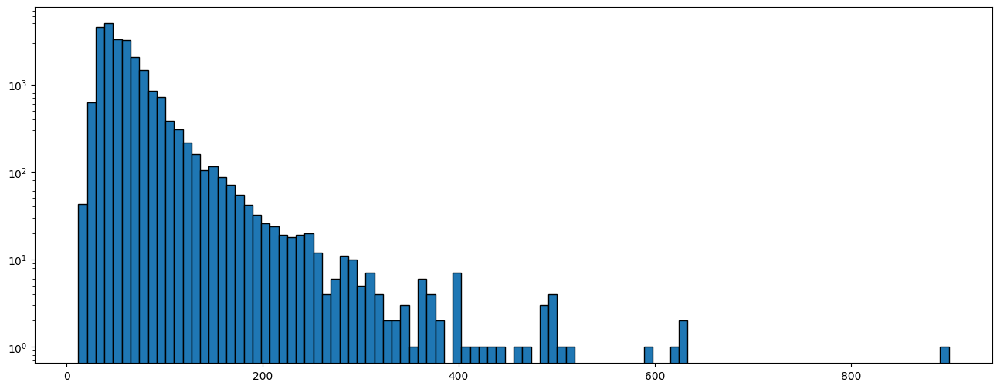

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
19540,8,420000000.0,900.0,2017-12-06T00:00:00,12,2.80,25.0,409.7,25,0,...,112.0,0,Санкт-Петербург,30706.0,7877.0,0.0,NaN,2.0,318.0,106.0
12859,20,140000000.0,631.2,2019-04-09T00:00:00,7,3.90,4.0,322.3,4,0,...,19.5,1,Санкт-Петербург,25707.0,4972.0,0.0,NaN,2.0,210.0,NaN
3117,19,140000000.0,631.0,2019-03-30T00:00:00,7,NaN,5.0,NaN,5,0,...,60.0,0,Санкт-Петербург,25707.0,4972.0,0.0,NaN,2.0,210.0,NaN
15651,20,300000000.0,618.0,2017-12-18T00:00:00,7,3.40,7.0,258.0,5,0,...,70.0,0,Санкт-Петербург,32440.0,5297.0,0.0,NaN,2.0,198.0,111.0
5358,20,65000000.0,590.0,2019-02-14T00:00:00,15,3.50,6.0,409.0,3,0,...,100.0,0,Санкт-Петербург,24447.0,4666.0,1.0,767.0,0.0,NaN,14.0
4237,1,50000000.0,517.0,2017-10-14T00:00:00,7,NaN,4.0,332.0,3,0,...,22.0,0,Санкт-Петербург,22835.0,1847.0,2.0,477.0,2.0,540.0,NaN
8018,20,84000000.0,507.0,2015-12-17T00:00:00,5,4.45,7.0,301.5,7,1,...,45.5,1,Санкт-Петербург,NaN,5735.0,2.0,110.0,0.0,NaN,1078.0


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
19904,4,2400000.0,12.0,2017-07-19T00:00:00,1,2.55,5.0,10.0,2,0,...,NaN,0,Санкт-Петербург,21314.0,964.0,1.0,886.0,2.0,45.0,200.0
17961,3,1400000.0,13.0,2017-12-03T00:00:00,1,2.60,9.0,NaN,1,0,...,NaN,0,Санкт-Петербург,14350.0,15945.0,0.0,NaN,1.0,185.0,410.0
19546,3,1850000.0,13.0,2019-03-11T00:00:00,1,3.40,5.0,NaN,2,0,...,NaN,0,Санкт-Петербург,24915.0,5483.0,1.0,644.0,0.0,NaN,24.0
19807,0,3800000.0,13.0,2018-07-04T00:00:00,1,NaN,5.0,10.0,3,0,...,NaN,0,Санкт-Петербург,21302.0,1242.0,1.0,592.0,3.0,27.0,9.0
19558,2,1686000.0,13.2,2018-12-17T00:00:00,1,NaN,5.0,NaN,1,0,...,NaN,0,Санкт-Петербург,19891.0,4165.0,1.0,361.0,1.0,155.0,19.0
19642,5,1190000.0,14.0,2018-07-29T00:00:00,1,NaN,5.0,11.0,1,0,...,2.0,0,Санкт-Петербург,9898.0,11122.0,0.0,NaN,0.0,NaN,4.0


In [19]:
# Поиск выбросов в Общей площади
plt.figure(figsize=(16, 6))
plt.hist(data['total_area'], bins=100, edgecolor='black', log=True)
plt.show()

display(data[data['total_area'] > 500].sort_values(by = 'total_area', ascending = False))
display(data[data['total_area'] < 15].sort_values(by='total_area'))


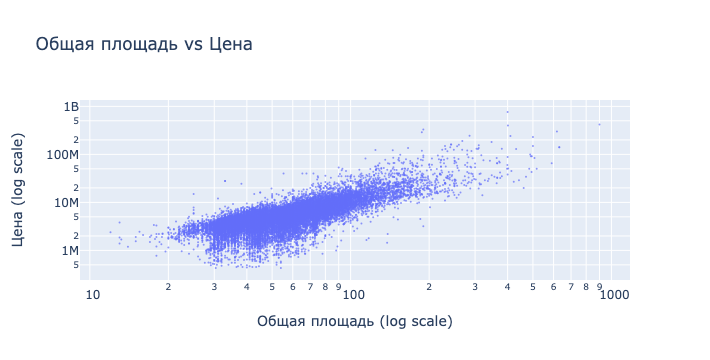

In [20]:
# Scatter график Общая площадь vs Цена

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['total_area'], 
    y=data['last_price'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')

fig.update_layout(
    title='Общая площадь vs Цена',
    xaxis_title='Общая площадь (log scale)',
    yaxis_title='Цена (log scale)'
)

fig.show()

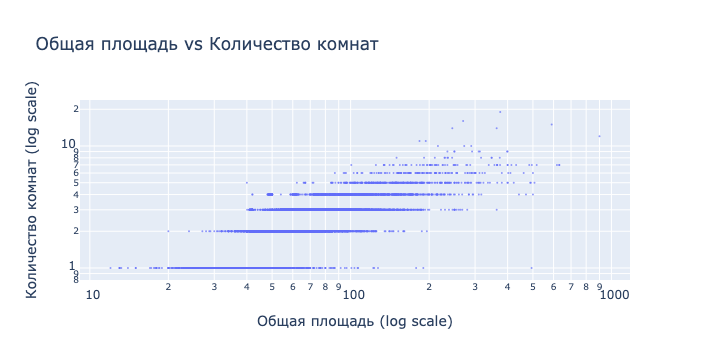

In [21]:
# Scatter график Общая площадь vs Количество комнат

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['total_area'], 
    y=data['rooms'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')

fig.update_layout(
    title='Общая площадь vs Количество комнат',
    xaxis_title='Общая площадь (log scale)',
    yaxis_title='Количество комнат (log scale)'
)

fig.show()

# Обнаружена одна подозрительная квартира с площадь около 500м2 и 1 комнатой, ничего не делаем

В столбце total_area не обнаружено аномалий, за исключением одной квартиры, найденной при анализе значений столбца rooms.

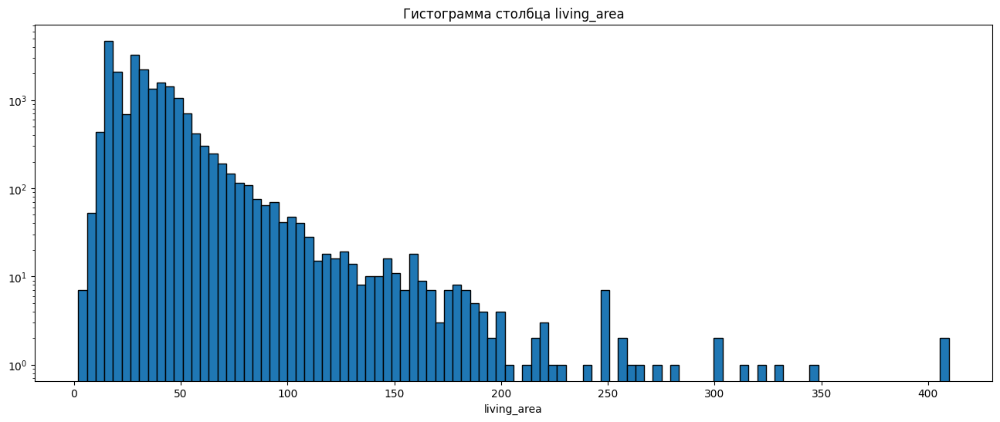

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
19540,8,420000000.0,900.0,2017-12-06T00:00:00,12,2.80,25.0,409.7,25,0,...,112.0,0,Санкт-Петербург,30706.0,7877.0,0.0,NaN,2.0,318.0,106.0
5358,20,65000000.0,590.0,2019-02-14T00:00:00,15,3.50,6.0,409.0,3,0,...,100.0,0,Санкт-Петербург,24447.0,4666.0,1.0,767.0,0.0,NaN,14.0
12401,20,91500000.0,495.0,2017-06-19T00:00:00,7,4.65,7.0,347.5,7,0,...,25.0,0,Санкт-Петербург,NaN,5735.0,2.0,110.0,0.0,NaN,14.0
4237,1,50000000.0,517.0,2017-10-14T00:00:00,7,NaN,4.0,332.0,3,0,...,22.0,0,Санкт-Петербург,22835.0,1847.0,2.0,477.0,2.0,540.0,NaN
12859,20,140000000.0,631.2,2019-04-09T00:00:00,7,3.90,4.0,322.3,4,0,...,19.5,1,Санкт-Петербург,25707.0,4972.0,0.0,NaN,2.0,210.0,NaN
660,3,49950000.0,483.9,2017-10-04T00:00:00,7,3.20,6.0,312.5,4,0,...,26.4,0,Санкт-Петербург,23079.0,945.0,3.0,461.0,3.0,22.0,391.0
8018,20,84000000.0,507.0,2015-12-17T00:00:00,5,4.45,7.0,301.5,7,1,...,45.5,1,Санкт-Петербург,NaN,5735.0,2.0,110.0,0.0,NaN,1078.0


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
21758,0,2330000.0,23.00,2018-01-01T00:00:00,0,NaN,24.0,2.0,22,0,...,NaN,0,посёлок Мурино,NaN,NaN,NaN,NaN,NaN,NaN,66.0
13915,20,6350000.0,52.00,2018-02-06T00:00:00,2,3.00,6.0,2.0,2,0,...,9.0,0,Санкт-Петербург,32453.0,6521.0,0.0,NaN,1.0,1012.0,91.0
23574,14,64990000.0,139.00,2015-11-24T00:00:00,3,3.00,8.0,3.0,8,0,...,16.0,1,Санкт-Петербург,33255.0,5975.0,1.0,630.0,3.0,100.0,280.0
3242,7,4440000.0,41.00,2017-07-02T00:00:00,1,NaN,17.0,3.0,17,0,...,11.0,0,Санкт-Петербург,19272.0,13073.0,0.0,NaN,0.0,NaN,216.0
17582,11,2680000.0,22.00,2018-08-11T00:00:00,0,NaN,25.0,5.0,8,0,...,NaN,2,Санкт-Петербург,22735.0,11618.0,1.0,835.0,1.0,652.0,70.0
21943,15,6100000.0,77.60,2019-02-28T00:00:00,4,2.50,9.0,5.4,1,0,...,9.8,0,Санкт-Петербург,29338.0,11270.0,1.0,584.0,0.0,NaN,33.0
16431,13,3799000.0,31.00,2018-04-12T00:00:00,1,2.60,5.0,6.0,1,0,...,17.0,0,Санкт-Петербург,32177.0,4826.0,1.0,430.0,0.0,NaN,168.0
19251,19,4050000.0,33.00,2018-10-15T00:00:00,1,2.50,22.0,6.5,21,0,...,18.0,0,Санкт-Петербург,9258.0,10592.0,1.0,458.0,0.0,NaN,44.0
20994,7,8900000.0,50.60,2018-10-22T00:00:00,2,2.50,7.0,8.0,3,0,...,31.0,0,Санкт-Петербург,12771.0,8301.0,1.0,173.0,3.0,126.0,NaN
23208,12,4800000.0,37.00,2016-02-24T00:00:00,1,NaN,14.0,8.0,11,0,...,22.0,0,Санкт-Петербург,27838.0,12387.0,2.0,358.0,1.0,950.0,139.0


In [22]:
# Анализ и обработка столбца living_area
plt.figure(figsize=(16, 6))
plt.hist(data['living_area'], bins=100, edgecolor='black', log=True)
plt.xlabel('living_area')
plt.title('Гистограмма столбца living_area')
plt.show()



# Поиск выбросов 
display(data[data['living_area'] > 300].sort_values(by = 'living_area', ascending = False))
display(data[data['living_area'] < 10].sort_values(by = 'living_area'))


In [23]:
# В нескольких квартирах исправляю наиболее вероятную опечатку на порядок, также есть подозрительная квартира, с общей площадью 139м2 
# и жилой площадью 3м2 - удаляю значение. 

data.loc[23574, 'living_area'] = pd.NA
data.loc[data['living_area'].isin([2.0, 3.0, 5.4]), 'living_area'] *= 10
data['living_area'] = pd.to_numeric(data['living_area'], errors='coerce')

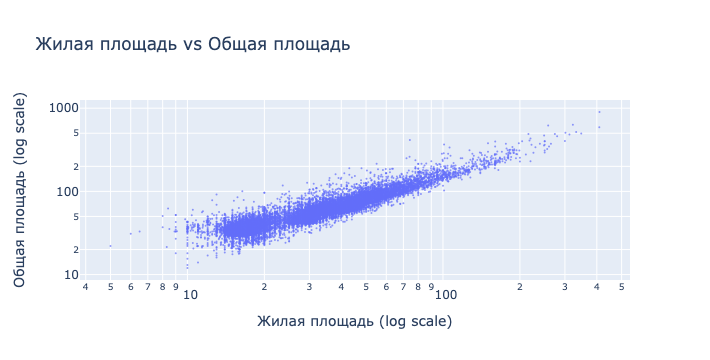

In [24]:
# Scatter график Жилая площадь vs Общая площадь

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['living_area'], 
    y=data['total_area'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')

fig.update_layout(
    title='Жилая площадь vs Общая площадь',
    xaxis_title='Жилая площадь (log scale)',
    yaxis_title='Общая площадь (log scale)'
)

fig.show()


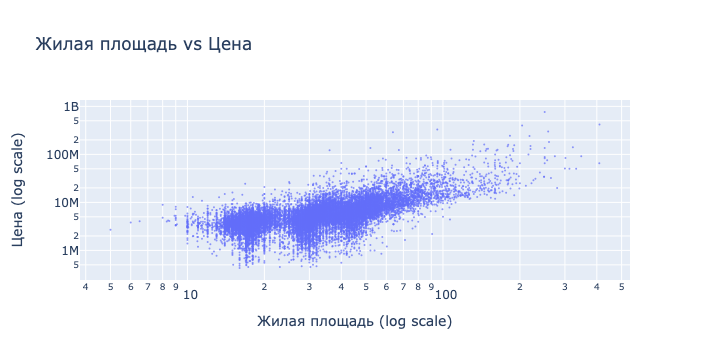

In [25]:
# Scatter график Жилая площадь vs Цена

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['living_area'], 
    y=data['last_price'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')

fig.update_layout(
    title='Жилая площадь vs Цена',
    xaxis_title='Жилая площадь (log scale)',
    yaxis_title='Цена (log scale)'
)

fig.show()

В столбце living_area обнаружено несколько аномалий, связанных с опечатками, а также несколько аномалий (малая жилая площадь по высокой цене и большая жилая площадь по низкой цене), которые решено оставить. 

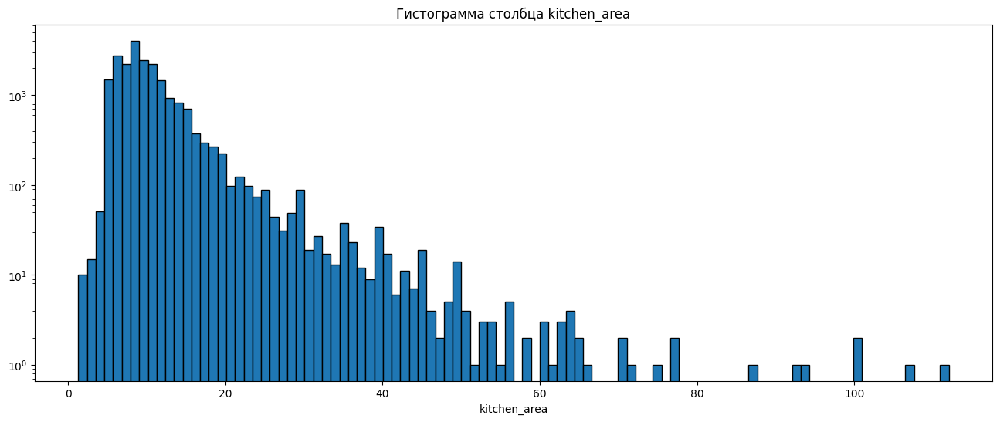

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
19540,8,420000000.0,900.0,2017-12-06T00:00:00,12,2.80,25.0,409.7,25,0,...,112.0,0,Санкт-Петербург,30706.0,7877.0,0.0,NaN,2.0,318.0,106.0
20215,2,85000000.0,249.7,2018-02-01T00:00:00,3,NaN,10.0,72.0,9,0,...,107.0,4,Санкт-Петербург,31532.0,4624.0,1.0,2218.0,2.0,99.0,26.0
2489,9,12500000.0,255.0,2017-04-21T00:00:00,3,NaN,2.0,153.9,2,0,...,100.7,0,Санкт-Петербург,29544.0,6916.0,0.0,NaN,3.0,198.0,102.0
5358,20,65000000.0,590.0,2019-02-14T00:00:00,15,3.50,6.0,409.0,3,0,...,100.0,0,Санкт-Петербург,24447.0,4666.0,1.0,767.0,0.0,NaN,14.0
16239,5,82400000.0,181.1,2017-05-24T00:00:00,3,3.90,9.0,58.2,4,0,...,93.2,0,Санкт-Петербург,25525.0,5845.0,2.0,116.0,0.0,NaN,501.0
16797,9,65850000.0,146.0,2017-07-14T00:00:00,2,NaN,9.0,40.0,3,0,...,93.0,0,Санкт-Петербург,25525.0,5845.0,2.0,116.0,0.0,NaN,77.0
10867,1,56844500.0,177.9,2015-01-15T00:00:00,3,NaN,6.0,87.2,5,1,...,87.2,0,Санкт-Петербург,21860.0,318.0,2.0,160.0,3.0,569.0,NaN
492,18,95000000.0,216.0,2017-12-05T00:00:00,4,3.00,5.0,86.0,4,0,...,77.0,0,Санкт-Петербург,21740.0,436.0,2.0,138.0,3.0,620.0,14.0
4394,20,57000000.0,174.0,2015-11-09T00:00:00,3,3.20,10.0,95.0,6,0,...,77.0,0,Санкт-Петербург,31706.0,4166.0,1.0,193.0,3.0,199.0,1039.0
14644,17,47000000.0,150.0,2017-02-28T00:00:00,4,3.70,6.0,58.0,5,0,...,75.0,1,Санкт-Петербург,16085.0,7616.0,0.0,NaN,0.0,NaN,507.0


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
20217,7,4250000.0,28.50,2019-05-01T00:00:00,1,2.80,14.0,19.5,10,0,...,1.30,0,Санкт-Петербург,37199.0,12721.0,0.0,NaN,0.0,NaN,NaN
906,15,2600000.0,27.00,2017-07-10T00:00:00,1,2.75,23.0,18.0,18,0,...,2.00,0,Санкт-Петербург,22131.0,17459.0,0.0,NaN,1.0,411.0,10.0
16367,2,2720000.0,25.70,2017-10-30T00:00:00,1,NaN,19.0,22.6,11,0,...,2.00,0,Санкт-Петербург,14472.0,13268.0,0.0,NaN,0.0,NaN,109.0
21419,4,1870000.0,20.00,2018-03-06T00:00:00,1,2.50,5.0,14.0,1,0,...,2.00,0,Санкт-Петербург,16652.0,15654.0,1.0,619.0,1.0,937.0,45.0
11033,6,5350000.0,32.00,2016-04-20T00:00:00,1,NaN,14.0,16.0,10,0,...,2.00,0,Санкт-Петербург,19008.0,3953.0,0.0,NaN,1.0,69.0,210.0
19642,5,1190000.0,14.00,2018-07-29T00:00:00,1,NaN,5.0,11.0,1,0,...,2.00,0,Санкт-Петербург,9898.0,11122.0,0.0,NaN,0.0,NaN,4.0
9138,17,2920000.0,23.29,2018-12-12T00:00:00,1,NaN,3.0,21.0,1,0,...,2.00,0,Санкт-Петербург,19506.0,4008.0,0.0,NaN,2.0,45.0,107.0
6262,9,3100000.0,24.00,2018-06-25T00:00:00,2,3.00,5.0,16.0,5,0,...,2.00,0,Санкт-Петербург,31960.0,4914.0,2.0,426.0,1.0,936.0,54.0
17834,5,2940000.0,34.70,2017-10-09T00:00:00,1,NaN,26.0,15.5,14,0,...,2.30,1,посёлок Мурино,NaN,NaN,NaN,NaN,NaN,NaN,318.0
8729,9,2200000.0,18.40,2018-08-20T00:00:00,1,2.52,3.0,14.0,3,0,...,2.40,0,Пушкин,20710.0,30687.0,0.0,NaN,1.0,155.0,59.0


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition


In [26]:
# Анализ и обработка столбца kitchen_area
plt.figure(figsize=(16, 6))
plt.hist(data['kitchen_area'], bins=100, edgecolor='black', log=True)
plt.xlabel('kitchen_area')
plt.title('Гистограмма столбца kitchen_area')
plt.show()

# Поиск выбросов 
display(data[data['kitchen_area'] > 60].sort_values(by = 'kitchen_area', ascending = False))
display(data[data['kitchen_area'] < 4].sort_values(by = 'kitchen_area'))
display(data[data['kitchen_area'] > data['total_area']].sort_values(by = 'kitchen_area'))

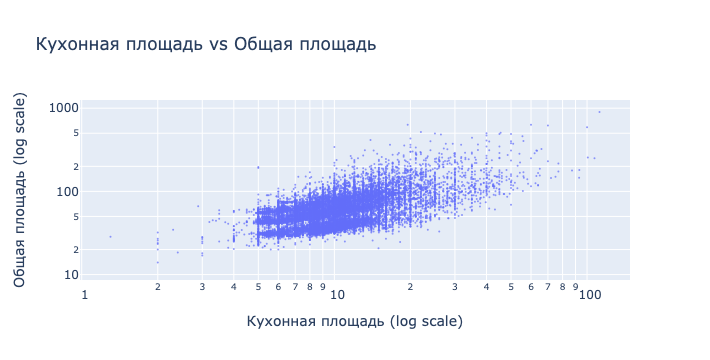

In [27]:
# Scatter график Кухонная площадь vs Общая площадь

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['kitchen_area'], 
    y=data['total_area'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')

fig.update_layout(
    title='Кухонная площадь vs Общая площадь',
    xaxis_title='Кухонная площадь (log scale)',
    yaxis_title='Общая площадь (log scale)'
)

fig.show()

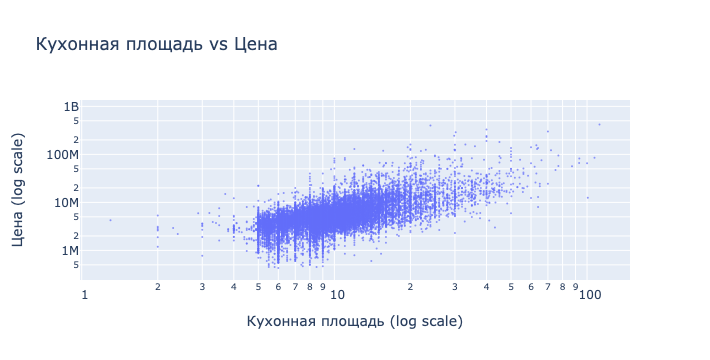

In [28]:
# Scatter график Кухонная площадь vs Цена

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['kitchen_area'], 
    y=data['last_price'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')

fig.update_layout(
    title='Кухонная площадь vs Цена',
    xaxis_title='Кухонная площадь (log scale)',
    yaxis_title='Цена (log scale)'
)

fig.show()

В столбце kitchen_area не обнаружено аномалий. 

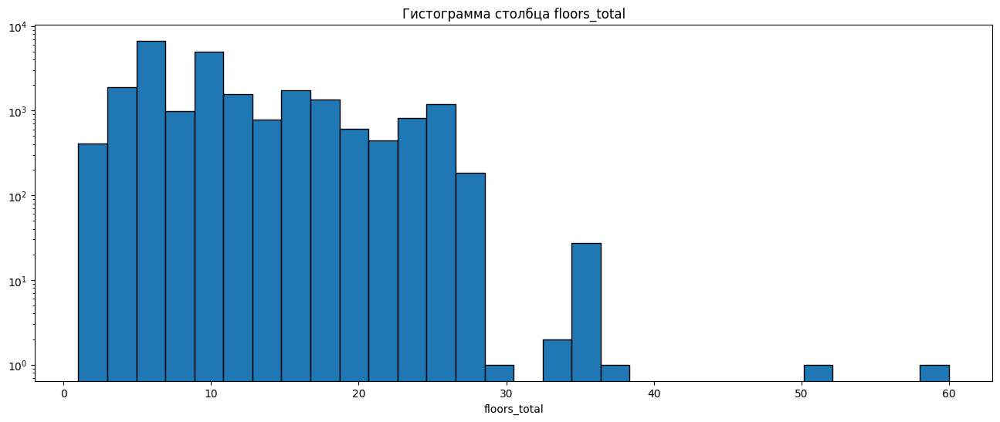

array([16., 11.,  5., 14., 12., 26., 24., 27.,  9.,  6., 17., 25.,  3.,
       23., 19., 18.,  4., 22.,  8.,  2., 10.,  7., 13., 15., nan, 20.,
       28., 36., 21., 35., 34., 60.,  1., 29., 33., 52., 37.])

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
2253,12,3800000.0,45.5,2018-06-28T00:00:00,2,2.88,60.0,27.4,4,0,...,7.4,0,Кронштадт,67763.0,49488.0,2.0,342.0,3.0,614.0,166.0
16731,9,3978000.0,40.0,2018-09-24T00:00:00,1,2.65,52.0,10.5,18,0,...,14.0,0,Санкт-Петербург,20728.0,12978.0,1.0,793.0,0.0,NaN,45.0


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition


In [29]:
# Анализ и обработка столбца floors_total
plt.figure(figsize=(16, 6))
plt.hist(data['floors_total'], bins=30, edgecolor='black', log=True)
plt.xlabel('floors_total')
plt.title('Гистограмма столбца floors_total')
plt.show()

# Поиск выбросов 
display(data['floors_total'].unique())
display(data[data['floors_total'] > 40].sort_values(by = 'floors_total', ascending = False))
display(data[data['floors_total'] < 1].sort_values(by = 'floors_total'))
display(data[data['floors_total'] < data['floor']].sort_values(by = 'floors_total'))


В столбце floors_total не обнаружено аномалий. 

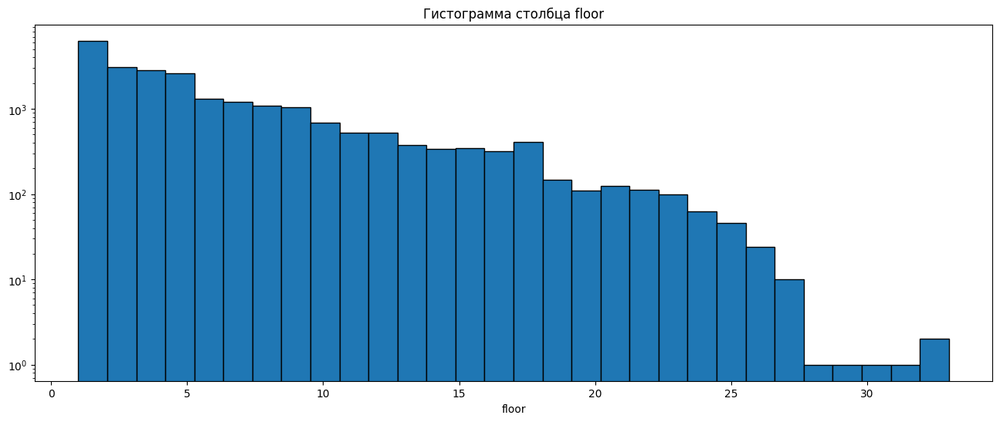

array([ 8,  1,  4,  9, 13,  5,  6, 22, 26,  7,  3,  2, 11, 15, 18, 10, 19,
       16, 20, 27, 25, 17, 14, 12, 21, 28, 24, 23, 30, 29, 32, 33, 31])

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition


In [30]:
# Анализ и обработка столбца floor
plt.figure(figsize=(16, 6))
plt.hist(data['floor'], bins=30, edgecolor='black', log=True)
plt.xlabel('floor')
plt.title('Гистограмма столбца floor')
plt.show()

# Поиск выбросов 
display(data['floor'].unique())
display(data[data['floor'] < 1].sort_values(by = 'floor'))

В столбце floor не обнаружено аномалий. 

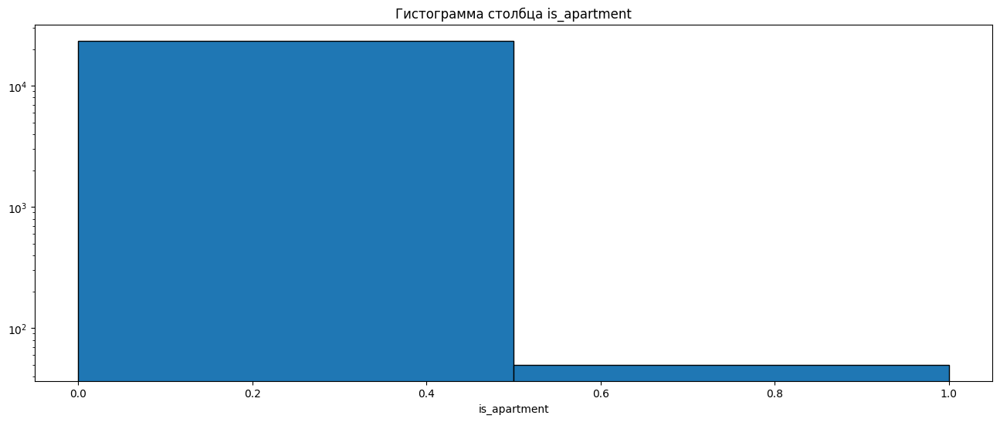

array([0, 1])

In [31]:
# Анализ и обработка столбца is_apartment
plt.figure(figsize=(16, 6))
plt.hist(data['is_apartment'].dropna(), bins=2, edgecolor='black', log=True)
plt.xlabel('is_apartment')
plt.title('Гистограмма столбца is_apartment')
plt.show()

# Поиск выбросов 
display(data['is_apartment'].unique())

В столбце is_apartment не обнаружено аномалий. 

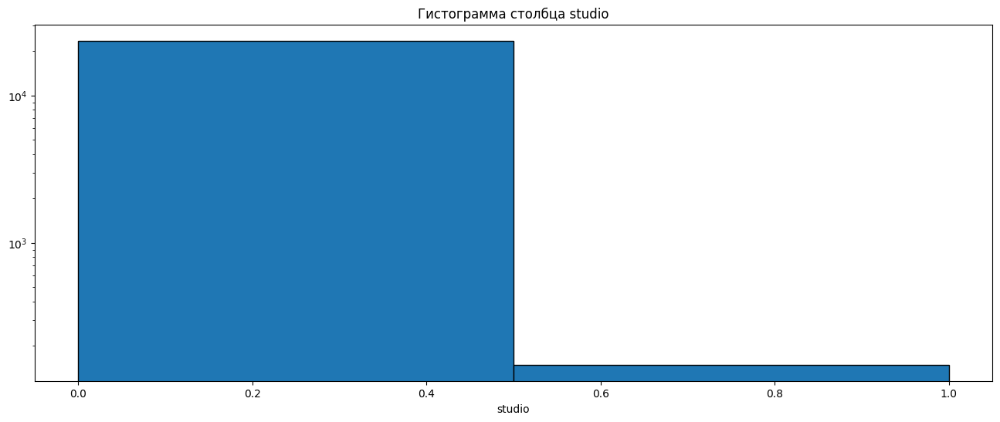

array([0, 1])

(array([138.,  11.]),
 array([0. , 0.5, 1. ]),
 <BarContainer object of 2 artists>)

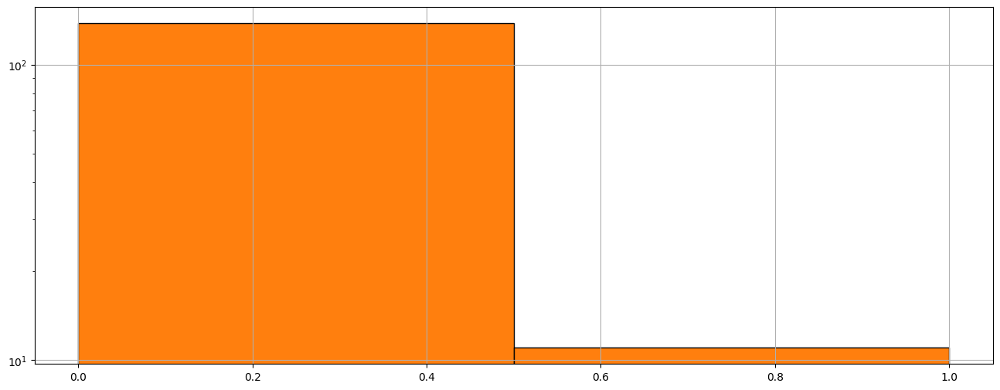

In [32]:
# Анализ и обработка столбца studio
plt.figure(figsize=(16, 6))
plt.hist(data['studio'].dropna(), bins=2, edgecolor='black', log=True)
plt.xlabel('studio')
plt.title('Гистограмма столбца studio')
plt.show()

# Поиск выбросов 
plt.figure(figsize=(16, 6))
display(data['studio'].unique())
data.query('(studio == 1)')['rooms'].hist()
plt.hist(data.query('(studio == 1)')['rooms'], bins=2, edgecolor='black', log=True)

# Есть 0-комнатные и 1-комнатные студии, что подозрительно, но оставим как есть

В столбце studio есть несколько квартир с одной комнатой, являющихся студией, что противоречит, тем не менее оставим как есть. 

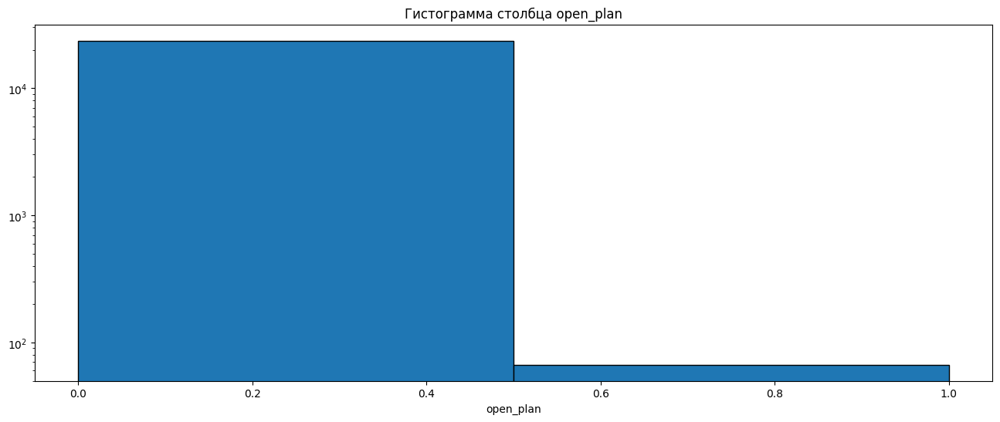

array([0, 1])

In [33]:
# Анализ и обработка столбца open_plan
plt.figure(figsize=(16, 6))
plt.hist(data['open_plan'].dropna(), bins=2, edgecolor='black', log=True)
plt.xlabel('open_plan')
plt.title('Гистограмма столбца open_plan')
plt.show()
display(data['open_plan'].unique())


В столбце open_plan не обнаружено аномалий. 

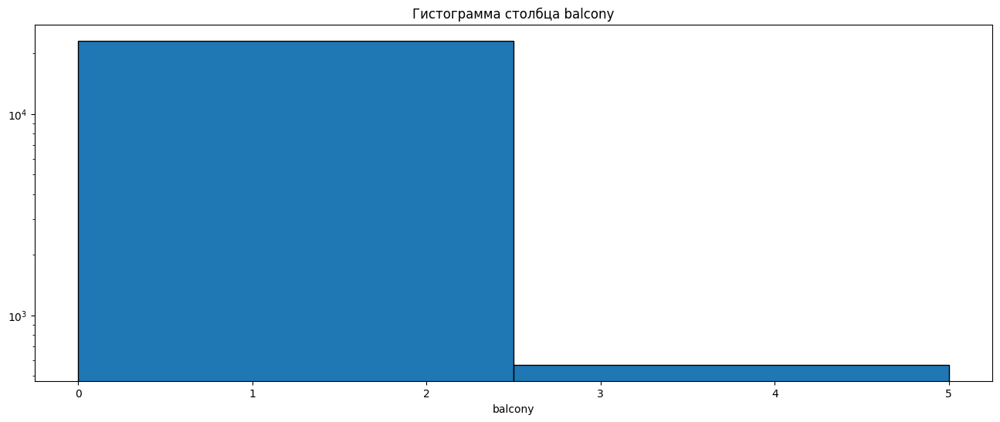

array([0, 2, 1, 5, 4, 3])

In [34]:
# Анализ и обработка столбца balcony
plt.figure(figsize=(16, 6))
plt.hist(data['balcony'].dropna(), bins=2, edgecolor='black', log=True)
plt.xlabel('balcony')
plt.title('Гистограмма столбца balcony')
plt.show()
display(data['balcony'].unique())


В столбце balcony не обнаружено аномалий. 

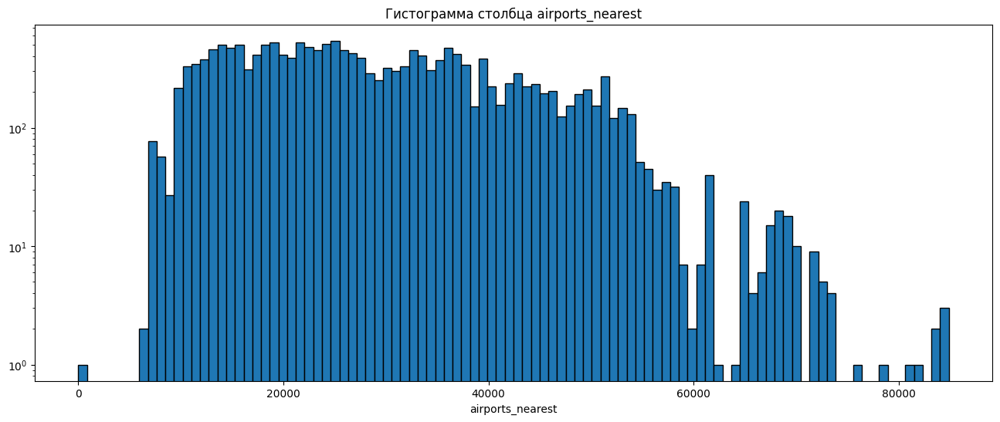

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
21085,0,7000000.0,34.7,2018-09-23T00:00:00,1,2.7,9.0,19.8,3,0,...,6.0,2,Санкт-Петербург,0.0,22801.0,0.0,NaN,0.0,NaN,60.0
12899,8,4199000.0,56.0,2017-12-21T00:00:00,2,NaN,9.0,27.0,5,0,...,15.0,0,Санкт-Петербург,6450.0,17461.0,0.0,NaN,1.0,444.0,24.0
4017,7,2268000.0,35.0,2017-12-21T00:00:00,1,NaN,9.0,14.0,6,0,...,8.0,0,Санкт-Петербург,6450.0,17461.0,0.0,NaN,1.0,444.0,25.0
7778,9,2750000.0,29.0,2017-02-19T00:00:00,1,2.5,4.0,15.0,1,0,...,6.0,0,Санкт-Петербург,6914.0,21486.0,1.0,215.0,0.0,NaN,43.0
23150,3,6490000.0,62.5,2015-03-18T00:00:00,2,NaN,24.0,33.5,15,0,...,9.0,4,Санкт-Петербург,6949.0,13165.0,1.0,711.0,0.0,NaN,917.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23683,16,2100000.0,62.8,2018-09-18T00:00:00,4,2.5,5.0,45.5,3,0,...,5.5,0,посёлок Дзержинского,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23692,2,1350000.0,30.0,2017-07-07T00:00:00,1,NaN,5.0,17.5,4,0,...,6.0,0,Тихвин,NaN,NaN,NaN,NaN,NaN,NaN,413.0
23695,14,3100000.0,59.0,2018-01-15T00:00:00,3,NaN,5.0,38.0,4,0,...,8.5,0,Тосно,NaN,NaN,NaN,NaN,NaN,NaN,45.0
23696,18,2500000.0,56.7,2018-02-11T00:00:00,2,NaN,3.0,29.7,1,0,...,NaN,0,село Рождествено,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
12899,8,4199000.0,56.0,2017-12-21T00:00:00,2,NaN,9.0,27.0,5,0,...,15.0,0,Санкт-Петербург,6450.0,17461.0,0.0,NaN,1.0,444.0,24.0
4017,7,2268000.0,35.0,2017-12-21T00:00:00,1,NaN,9.0,14.0,6,0,...,8.0,0,Санкт-Петербург,6450.0,17461.0,0.0,NaN,1.0,444.0,25.0
7778,9,2750000.0,29.0,2017-02-19T00:00:00,1,2.5,4.0,15.0,1,0,...,6.0,0,Санкт-Петербург,6914.0,21486.0,1.0,215.0,0.0,NaN,43.0
23150,3,6490000.0,62.5,2015-03-18T00:00:00,2,NaN,24.0,33.5,15,0,...,9.0,4,Санкт-Петербург,6949.0,13165.0,1.0,711.0,0.0,NaN,917.0
22283,20,6290000.0,54.9,2019-03-17T00:00:00,2,2.5,14.0,34.4,5,0,...,7.6,0,Санкт-Петербург,6989.0,13205.0,1.0,535.0,0.0,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23683,16,2100000.0,62.8,2018-09-18T00:00:00,4,2.5,5.0,45.5,3,0,...,5.5,0,посёлок Дзержинского,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23692,2,1350000.0,30.0,2017-07-07T00:00:00,1,NaN,5.0,17.5,4,0,...,6.0,0,Тихвин,NaN,NaN,NaN,NaN,NaN,NaN,413.0
23695,14,3100000.0,59.0,2018-01-15T00:00:00,3,NaN,5.0,38.0,4,0,...,8.5,0,Тосно,NaN,NaN,NaN,NaN,NaN,NaN,45.0
23696,18,2500000.0,56.7,2018-02-11T00:00:00,2,NaN,3.0,29.7,1,0,...,NaN,0,село Рождествено,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [35]:
# Анализ и обработка столбца airports_nearest
plt.figure(figsize=(16, 6))
plt.hist(data['airports_nearest'].dropna(), bins=100, edgecolor='black', log=True)
plt.xlabel('airports_nearest')
plt.title('Гистограмма столбца airports_nearest')
plt.show()

display(data.sort_values(by = 'airports_nearest'))
data.loc[21085, 'airports_nearest'] = pd.NA
data['airports_nearest'] = pd.to_numeric(data['airports_nearest'], errors = 'coerce')
display(data.sort_values(by = 'airports_nearest'))

В столбце airports_nearest обнаружена и удалена одна аномалия (расстояние до аэропорта 0 метров). 

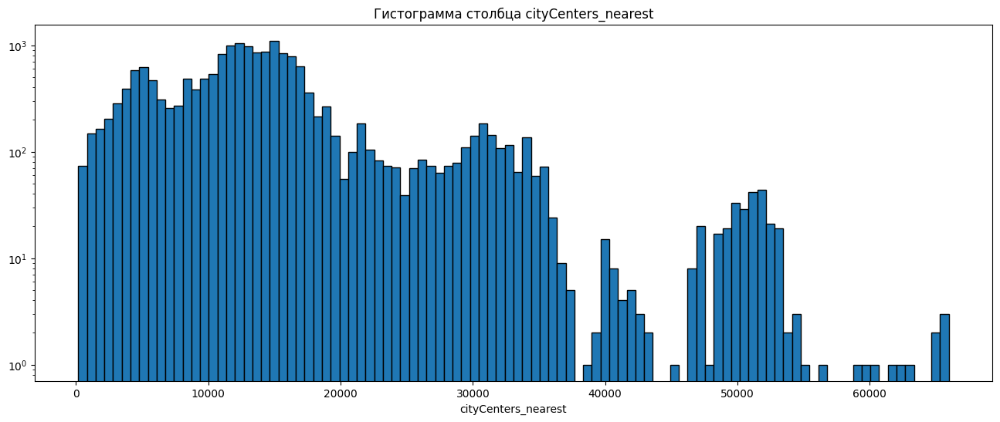

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
13694,2,31099000.0,159.0,2018-06-25T00:00:00,5,3.28,5.0,106.0,5,0,...,15.0,0,Санкт-Петербург,21633.0,181.0,2.0,254.0,3.0,426.0,NaN
1182,1,5800000.0,33.6,2016-03-10T00:00:00,1,3.70,7.0,22.8,4,0,...,6.6,0,Санкт-Петербург,21632.0,208.0,3.0,304.0,3.0,503.0,167.0
8614,7,10990000.0,100.0,2015-12-16T00:00:00,3,3.90,5.0,37.8,3,0,...,11.6,0,Санкт-Петербург,21818.0,215.0,3.0,229.0,2.0,511.0,265.0
1934,18,9590000.0,108.0,2017-05-23T00:00:00,2,3.30,5.0,59.0,2,0,...,11.0,0,Санкт-Петербург,21908.0,287.0,3.0,359.0,3.0,290.0,69.0
20873,18,11500000.0,113.5,2018-09-17T00:00:00,3,4.20,7.0,44.2,6,0,...,21.7,1,Санкт-Петербург,21739.0,291.0,2.0,472.0,2.0,94.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23683,16,2100000.0,62.8,2018-09-18T00:00:00,4,2.50,5.0,45.5,3,0,...,5.5,0,посёлок Дзержинского,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23692,2,1350000.0,30.0,2017-07-07T00:00:00,1,NaN,5.0,17.5,4,0,...,6.0,0,Тихвин,NaN,NaN,NaN,NaN,NaN,NaN,413.0
23695,14,3100000.0,59.0,2018-01-15T00:00:00,3,NaN,5.0,38.0,4,0,...,8.5,0,Тосно,NaN,NaN,NaN,NaN,NaN,NaN,45.0
23696,18,2500000.0,56.7,2018-02-11T00:00:00,2,NaN,3.0,29.7,1,0,...,NaN,0,село Рождествено,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
9640,8,4200000.0,51.4,2014-12-10T00:00:00,2,2.55,5.0,31.0,2,0,...,6.0,1,посёлок Молодёжное,84869.0,65968.0,0.0,NaN,0.0,NaN,1194.0
5340,19,3600000.0,50.6,2019-03-19T00:00:00,2,2.50,5.0,29.9,4,0,...,7.0,1,посёлок Молодёжное,84853.0,65952.0,0.0,NaN,0.0,NaN,NaN
577,7,4000000.0,59.0,2017-07-23T00:00:00,3,2.50,5.0,37.0,1,0,...,7.0,0,посёлок Молодёжное,84665.0,65764.0,0.0,NaN,0.0,NaN,NaN
20746,1,3300000.0,43.5,2016-02-16T00:00:00,2,2.55,4.0,27.2,2,0,...,5.0,1,посёлок Молодёжное,84006.0,65105.0,0.0,NaN,0.0,NaN,1043.0
5218,15,3650000.0,53.8,2018-09-24T00:00:00,3,2.50,4.0,36.9,3,0,...,5.2,0,посёлок Молодёжное,83758.0,64857.0,0.0,NaN,0.0,NaN,121.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23683,16,2100000.0,62.8,2018-09-18T00:00:00,4,2.50,5.0,45.5,3,0,...,5.5,0,посёлок Дзержинского,NaN,NaN,NaN,NaN,NaN,NaN,NaN
23692,2,1350000.0,30.0,2017-07-07T00:00:00,1,NaN,5.0,17.5,4,0,...,6.0,0,Тихвин,NaN,NaN,NaN,NaN,NaN,NaN,413.0
23695,14,3100000.0,59.0,2018-01-15T00:00:00,3,NaN,5.0,38.0,4,0,...,8.5,0,Тосно,NaN,NaN,NaN,NaN,NaN,NaN,45.0
23696,18,2500000.0,56.7,2018-02-11T00:00:00,2,NaN,3.0,29.7,1,0,...,NaN,0,село Рождествено,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [36]:
# Анализ и обработка столбца cityCenters_nearest
plt.figure(figsize=(16, 6))
plt.hist(data['cityCenters_nearest'].dropna(), bins=100, edgecolor='black', log=True)
plt.xlabel('cityCenters_nearest')
plt.title('Гистограмма столбца cityCenters_nearest')
plt.show()

display(data.sort_values(by = 'cityCenters_nearest'))
display(data.sort_values(by = 'cityCenters_nearest', ascending = False))

В столбце cityCenters_nearest не обнаружено аномалий. 

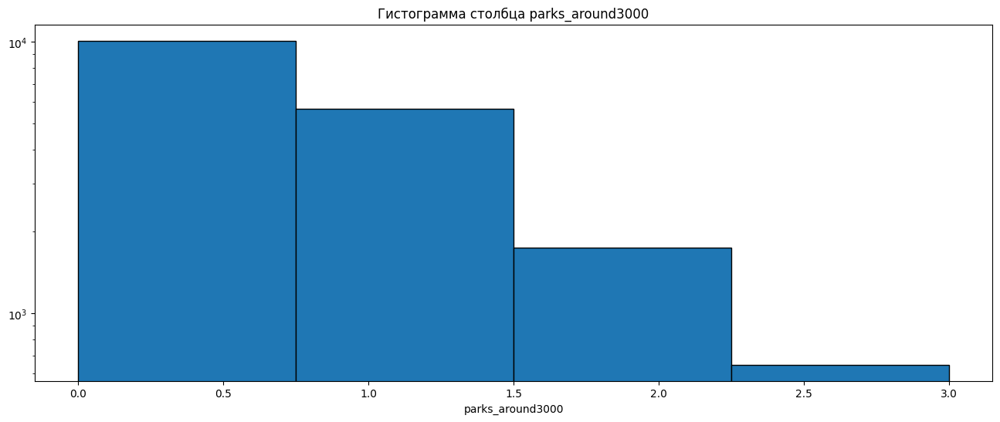

array([ 1.,  0.,  2., nan,  3.])

In [37]:
# Анализ и обработка столбца parks_around3000
plt.figure(figsize=(16, 6))
plt.hist(data['parks_around3000'].dropna(), bins=4, edgecolor='black', log=True)
plt.xlabel('parks_around3000')
plt.title('Гистограмма столбца parks_around3000')
plt.show()

display(data['parks_around3000'].unique())

В столбце parks_around3000 не обнаружено аномалий. 

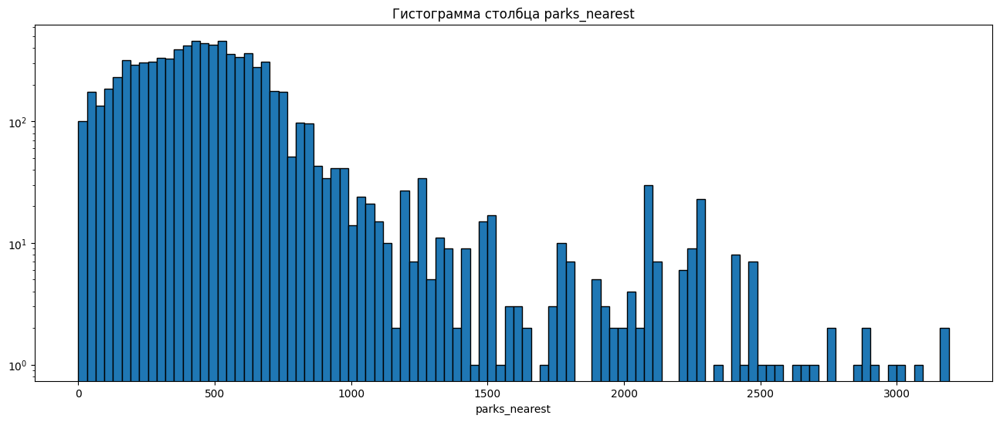

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
14624,8,3770000.0,45.4,2019-03-20T00:00:00,2,NaN,9.0,28.43,2,0,...,6.9,0,Санкт-Петербург,43932.0,16436.0,1.0,1.0,0.0,NaN,42.0
11949,7,4500000.0,44.0,2017-11-24T00:00:00,2,2.60,9.0,30.00,7,0,...,7.0,0,Санкт-Петербург,11806.0,12292.0,1.0,3.0,1.0,508.0,82.0
22941,8,10965000.0,69.3,2019-01-10T00:00:00,1,3.00,4.0,48.90,4,1,...,NaN,2,Зеленогорск,73391.0,54490.0,3.0,4.0,1.0,217.0,110.0
9344,12,3000000.0,28.1,2017-07-25T00:00:00,1,2.50,9.0,17.00,1,0,...,5.6,0,Санкт-Петербург,12051.0,11665.0,1.0,7.0,1.0,780.0,440.0
20193,3,11809670.0,102.6,2017-04-21T00:00:00,3,NaN,9.0,NaN,3,0,...,17.8,2,Санкт-Петербург,27562.0,6410.0,2.0,9.0,2.0,480.0,90.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23691,11,9470000.0,72.9,2016-10-13T00:00:00,2,2.75,25.0,40.30,7,0,...,10.6,1,Санкт-Петербург,19424.0,4489.0,0.0,NaN,1.0,806.0,519.0
23692,2,1350000.0,30.0,2017-07-07T00:00:00,1,NaN,5.0,17.50,4,0,...,6.0,0,Тихвин,NaN,NaN,NaN,NaN,NaN,NaN,413.0
23695,14,3100000.0,59.0,2018-01-15T00:00:00,3,NaN,5.0,38.00,4,0,...,8.5,0,Тосно,NaN,NaN,NaN,NaN,NaN,NaN,45.0
23696,18,2500000.0,56.7,2018-02-11T00:00:00,2,NaN,3.0,29.70,1,0,...,NaN,0,село Рождествено,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition


In [38]:
# Анализ и обработка столбца parks_nearest
plt.figure(figsize=(16, 6))
plt.hist(data['parks_nearest'].dropna(), bins=100, edgecolor='black', log=True)
plt.xlabel('parks_nearest')
plt.title('Гистограмма столбца parks_nearest')
plt.show()

display(data.sort_values(by = 'parks_nearest'))

display(data.query('(parks_around3000 > 0) & (parks_nearest > 3000)'))

display(data.query('(parks_around3000 == 0) & (parks_nearest < 3000)'))

В столбце parks_nearest не обнаружено аномалий. 

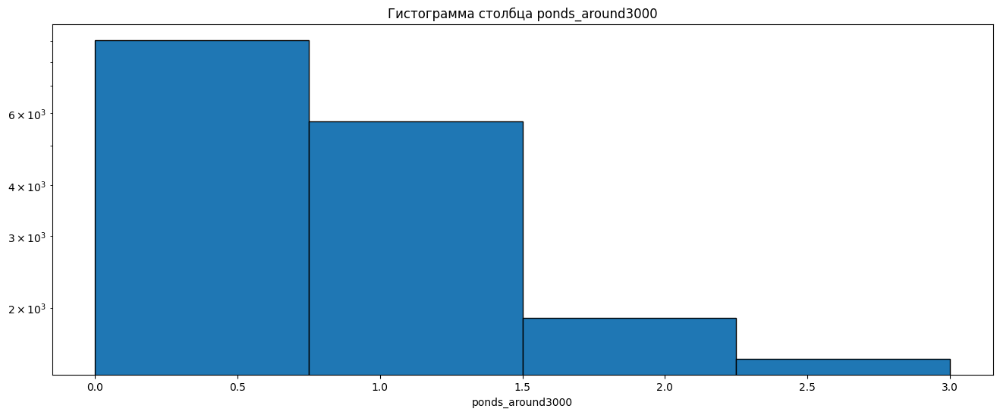

array([ 2.,  0.,  3.,  1., nan])

In [39]:
# Анализ и обработка столбца ponds_around3000
plt.figure(figsize=(16, 6))
plt.hist(data['ponds_around3000'].dropna(), bins=4, edgecolor='black', log=True)
plt.xlabel('ponds_around3000')
plt.title('Гистограмма столбца ponds_around3000')
plt.show()

display(data['ponds_around3000'].unique())

В столбце ponds_around3000 не обнаружено аномалий. 

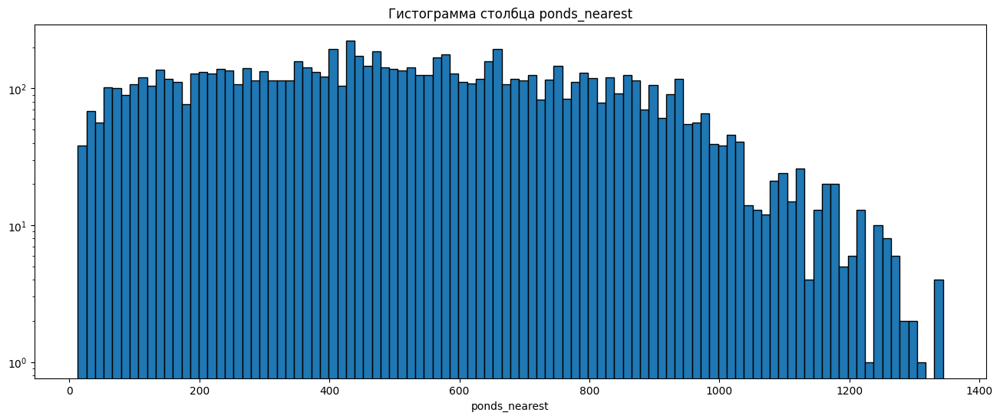

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
17585,14,12900000.0,86.0,2018-12-08T00:00:00,3,NaN,8.0,45.000000,7,0,...,22.00,0,Санкт-Петербург,18689.0,17691.0,1.0,1145.0,2.0,13.0,NaN
1548,1,12300000.0,90.0,2018-03-03T00:00:00,3,NaN,8.0,55.000000,3,0,...,14.00,0,Санкт-Петербург,18689.0,17691.0,1.0,1145.0,2.0,13.0,347.0
23343,12,11900000.0,85.0,2017-04-10T00:00:00,3,NaN,8.0,51.000000,7,0,...,13.60,0,Санкт-Петербург,18140.0,17143.0,1.0,1514.0,2.0,16.0,475.0
10358,8,16399282.0,205.0,2017-06-29T00:00:00,4,NaN,8.0,84.690000,1,0,...,11.36,0,Санкт-Петербург,18140.0,17143.0,1.0,1514.0,2.0,16.0,NaN
20427,1,12600000.0,129.0,2017-05-11T00:00:00,5,NaN,8.0,81.899994,3,0,...,14.40,1,Санкт-Петербург,18140.0,17143.0,1.0,1514.0,2.0,16.0,90.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23690,3,5500000.0,52.0,2018-07-19T00:00:00,2,NaN,5.0,31.000000,2,0,...,6.00,0,Санкт-Петербург,20151.0,6263.0,1.0,300.0,0.0,NaN,15.0
23692,2,1350000.0,30.0,2017-07-07T00:00:00,1,NaN,5.0,17.500000,4,0,...,6.00,0,Тихвин,NaN,NaN,NaN,NaN,NaN,NaN,413.0
23695,14,3100000.0,59.0,2018-01-15T00:00:00,3,NaN,5.0,38.000000,4,0,...,8.50,0,Тосно,NaN,NaN,NaN,NaN,NaN,NaN,45.0
23696,18,2500000.0,56.7,2018-02-11T00:00:00,2,NaN,3.0,29.700000,1,0,...,NaN,0,село Рождествено,NaN,NaN,NaN,NaN,NaN,NaN,NaN


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition


,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition


In [40]:
# Анализ и обработка столбца ponds_nearest
plt.figure(figsize=(16, 6))
plt.hist(data['ponds_nearest'].dropna(), bins=100, edgecolor='black', log=True)
plt.xlabel('ponds_nearest')
plt.title('Гистограмма столбца ponds_nearest')
plt.show()

display(data.sort_values(by = 'ponds_nearest'))

display(data.query('(ponds_around3000 > 0) & (ponds_nearest > 3000)'))

display(data.query('(ponds_around3000 == 0) & (ponds_nearest < 3000)'))

В столбце ponds_nearest не обнаружено аномалий. 

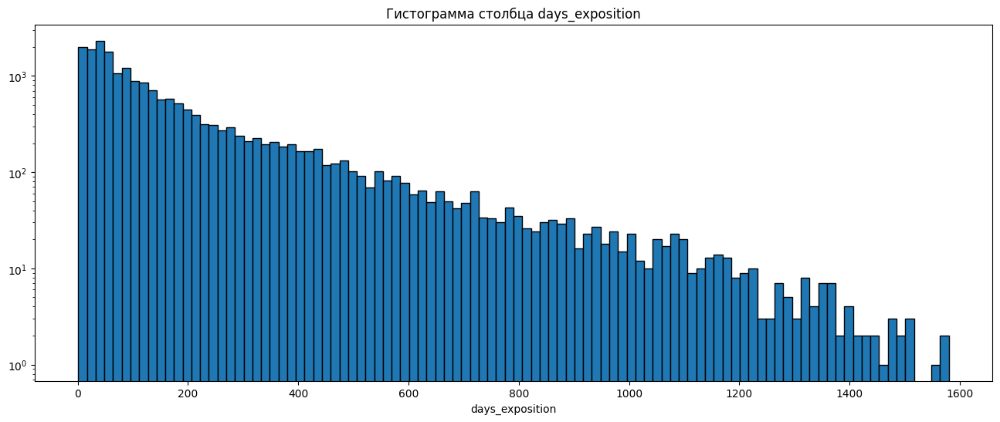

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
1632,19,4000000.0,49.90,2019-05-01T00:00:00,2,2.5,9.0,25.0,1,0,...,10.00,0,Санкт-Петербург,13567.0,14384.0,1.0,20.0,1.0,681.0,1.0
16053,4,4070000.0,45.10,2019-04-30T00:00:00,2,NaN,5.0,22.7,3,0,...,6.60,0,Санкт-Петербург,40859.0,11668.0,2.0,485.0,0.0,NaN,2.0
13061,20,6100000.0,51.40,2019-04-29T00:00:00,2,3.0,5.0,31.7,4,0,...,6.90,1,Санкт-Петербург,10776.0,9389.0,0.0,NaN,0.0,NaN,2.0
16212,0,7806000.0,25.00,2019-04-30T00:00:00,1,3.0,5.0,NaN,5,0,...,NaN,0,Санкт-Петербург,36525.0,10302.0,0.0,NaN,0.0,NaN,2.0
18680,9,3200000.0,36.80,2018-03-20T00:00:00,1,2.6,10.0,17.8,6,0,...,8.20,1,Санкт-Петербург,36908.0,12117.0,0.0,NaN,0.0,NaN,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
23684,20,21400000.0,145.00,2018-11-02T00:00:00,4,3.0,26.0,71.4,17,0,...,15.60,0,Санкт-Петербург,11827.0,11459.0,0.0,NaN,0.0,NaN,NaN
23685,15,2490000.0,31.00,2019-01-24T00:00:00,1,2.5,5.0,17.3,5,0,...,5.60,1,Ломоносов,48393.0,51818.0,0.0,NaN,0.0,NaN,NaN
23694,9,9700000.0,133.81,2017-03-21T00:00:00,3,3.7,5.0,73.3,3,0,...,13.83,0,Санкт-Петербург,24665.0,4232.0,1.0,796.0,3.0,381.0,NaN
23696,18,2500000.0,56.70,2018-02-11T00:00:00,2,NaN,3.0,29.7,1,0,...,NaN,0,село Рождествено,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [41]:
# Анализ и обработка столбца days_exposition
plt.figure(figsize=(16, 6))
plt.hist(data['days_exposition'].dropna(), bins=100, edgecolor='black', log=True)
plt.xlabel('days_exposition')
plt.title('Гистограмма столбца days_exposition')
plt.show()

display(data.sort_values(by = 'days_exposition'))

В столбце days_exposition не обнаружено аномалий. 

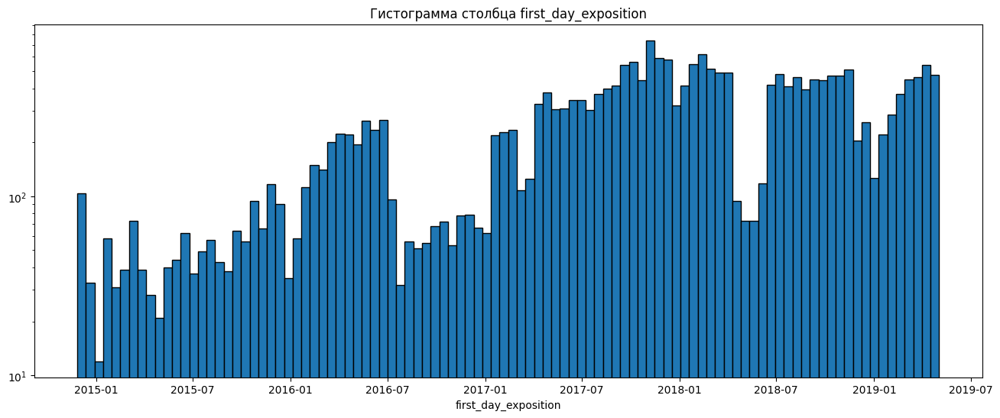

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
10132,2,16137000.0,154.76,2014-11-27T00:00:00,4,2.70,20.0,67.81,20,0,...,32.55,0,Санкт-Петербург,18490.0,17492.0,0.0,NaN,2.0,113.0,573.0
8393,10,8037000.0,56.20,2014-11-27T00:00:00,1,NaN,5.0,24.20,5,0,...,12.90,0,Санкт-Петербург,36813.0,8572.0,1.0,2467.0,3.0,214.0,972.0
15857,6,25000000.0,145.20,2014-11-27T00:00:00,3,NaN,5.0,60.70,5,0,...,40.20,0,Санкт-Петербург,36779.0,14931.0,0.0,NaN,0.0,NaN,NaN
2831,9,5990000.0,64.40,2014-11-27T00:00:00,2,3.12,4.0,36.20,1,0,...,14.60,0,Санкт-Петербург,24668.0,5236.0,1.0,366.0,0.0,NaN,1069.0
696,1,3364930.0,34.69,2014-11-27T00:00:00,1,2.64,25.0,23.43,25,0,...,23.43,2,Санкт-Петербург,43396.0,12153.0,0.0,NaN,0.0,NaN,574.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10917,20,10000000.0,62.30,2019-05-03T00:00:00,2,NaN,6.0,20.00,3,0,...,30.00,0,Санкт-Петербург,25083.0,3148.0,2.0,629.0,0.0,NaN,NaN
5986,0,5000000.0,48.00,2019-05-03T00:00:00,3,2.50,9.0,NaN,2,0,...,NaN,0,Санкт-Петербург,51060.0,16892.0,0.0,NaN,0.0,NaN,NaN
9217,7,4300000.0,35.70,2019-05-03T00:00:00,1,2.70,21.0,15.00,12,0,...,13.00,2,посёлок Мурино,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21887,0,5600000.0,61.60,2019-05-03T00:00:00,3,2.50,9.0,42.00,5,0,...,8.30,0,Санкт-Петербург,36326.0,10641.0,1.0,637.0,0.0,NaN,NaN


Timestamp('2019-05-02 00:00:00')

In [42]:
# Анализ и обработка столбца first_day_exposition
plt.figure(figsize=(16, 6))
plt.hist(pd.to_datetime(data['first_day_exposition'].dropna(), format = '%Y-%m-%dT%H:%M:%S'), bins=100, edgecolor='black', log=True)
plt.xlabel('first_day_exposition')
plt.title('Гистограмма столбца first_day_exposition')
plt.show()

display(data.sort_values(by = 'first_day_exposition'))

data_new = pd.DataFrame()
data_new['init'] = pd.to_datetime(data['first_day_exposition'])
data_new['add'] = data['days_exposition']

data_new.dropna(inplace = True)

def add_days(row):
    return pd.to_datetime(row['init']) + pd.DateOffset(days=row['add'])

data_new.apply(add_days, axis=1).max()


В столбце first_day_exposition не обнаружено аномалий. 

Заполнены пропуски в некоторых из столбцов, исправлены неявные дубликаты в названиях населенных пунктов, выявлены и устранены аномалии в данных там, где это возможно. 

## Создание новых признаков

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition,meter_price
12971,19,763000000.0,400.00,2017-09-30T00:00:00,7,NaN,10.0,250.00,10,0,...,2,Санкт-Петербург,25108.0,3956.0,1.0,530.0,3.0,756.0,33.0,1.907500e+06
1436,19,330000000.0,190.00,2018-04-04T00:00:00,3,3.50,7.0,95.00,5,0,...,0,Санкт-Петербург,23011.0,1197.0,3.0,519.0,3.0,285.0,233.0,1.736842e+06
22831,18,289238400.0,187.50,2019-03-19T00:00:00,2,3.37,6.0,63.70,6,0,...,0,Санкт-Петербург,22494.0,1073.0,3.0,386.0,3.0,188.0,NaN,1.542605e+06
14706,15,401300000.0,401.00,2016-02-20T00:00:00,5,NaN,9.0,204.00,9,0,...,3,Санкт-Петербург,21912.0,2389.0,1.0,545.0,1.0,478.0,393.0,1.000748e+06
4996,20,124000000.0,124.50,2017-10-12T00:00:00,4,3.00,4.0,67.20,2,0,...,0,Санкт-Петербург,20399.0,1722.0,3.0,302.0,3.0,172.0,45.0,9.959839e+05
16461,17,245000000.0,285.70,2017-04-10T00:00:00,6,3.35,7.0,182.80,4,0,...,0,Санкт-Петербург,33143.0,6235.0,3.0,400.0,3.0,140.0,249.0,8.575429e+05
4859,16,28000000.0,33.00,2019-04-29T00:00:00,1,3.50,5.0,NaN,2,0,...,0,Санкт-Петербург,23447.0,1376.0,3.0,344.0,3.0,119.0,NaN,8.484848e+05
17172,14,28000000.0,33.00,2019-04-30T00:00:00,1,3.50,5.0,NaN,2,0,...,0,Санкт-Петербург,23403.0,1462.0,3.0,342.0,3.0,27.0,NaN,8.484848e+05
16647,15,122000000.0,145.00,2017-04-25T00:00:00,3,3.30,6.0,36.00,2,0,...,0,Санкт-Петербург,33931.0,7023.0,2.0,478.0,3.0,250.0,335.0,8.413793e+05
17912,17,135000000.0,166.00,2019-02-07T00:00:00,3,3.30,7.0,52.00,1,0,...,0,Санкт-Петербург,32863.0,5955.0,2.0,230.0,3.0,215.0,NaN,8.132530e+05


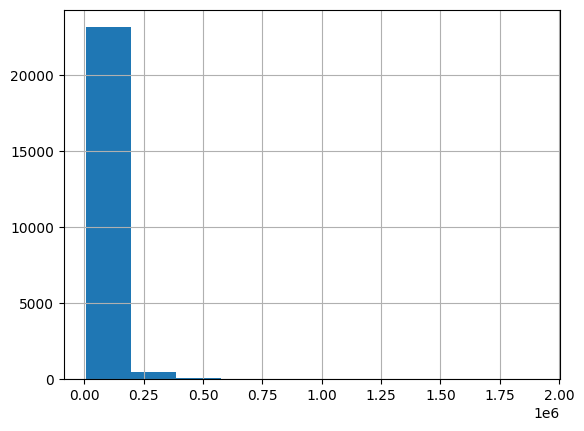

In [43]:
# Создание столбца стоимости квадратного метра
data['meter_price'] = data['last_price']/data['total_area']
data['meter_price'].hist()

data[data['meter_price'] > data['meter_price'].median()*5].sort_values(by = 'meter_price', ascending = False)

In [44]:
# Создание столбца первого дня экспозиции
data['day'] = pd.to_datetime(data['first_day_exposition']).dt.weekday
data['day'].unique()

array([3, 1, 4, 0, 2, 6, 5], dtype=int32)

In [45]:
# Создание столбца первого месяца экспозиции
data['month'] = pd.to_datetime(data['first_day_exposition']).dt.month
data['month'] = pd.to_datetime(data['first_day_exposition']).dt.strftime('%B')
data['month'].unique()

array(['March', 'December', 'August', 'July', 'June', 'September',
       'November', 'April', 'May', 'February', 'January', 'October'],
      dtype=object)

In [46]:
# Создание столбца первого года экспозиции
data['year'] = pd.to_datetime(data['first_day_exposition']).dt.year
data['year'].unique()

array([2019, 2018, 2015, 2017, 2016, 2014], dtype=int32)

In [47]:
# Создание столбца тип этажа

def floor_typer(floor, total_floors):
    if floor == 1: 
        return 'первый'
    elif floor == total_floors:
        return 'последний'
    else:
        return 'другой'

data['floor_type'] = data.apply(lambda row: floor_typer(row['floor'], row['floors_total']), axis=1)
data['floor_type'].unique()

array(['другой', 'первый', 'последний'], dtype=object)

In [48]:
# Создание столбца расстояние до центра в километрах

data['cityCenters_nearest_km'] = data['cityCenters_nearest']/1000
data['cityCenters_nearest_km'] = data['cityCenters_nearest_km'].round()
data[['cityCenters_nearest_km', 'cityCenters_nearest']].head(5)

,cityCenters_nearest_km,cityCenters_nearest
0,16.0,16028.0
1,19.0,18603.0
2,14.0,13933.0
3,7.0,6800.0
4,8.0,8098.0


В датасет добавлены новые столбцы для более детального анализа данных: цена квадратного метра, день, месяц, год размещения объявления, тип этажа, удаленность объекта от центра города в километрах.

## Исследовательский анализ данных

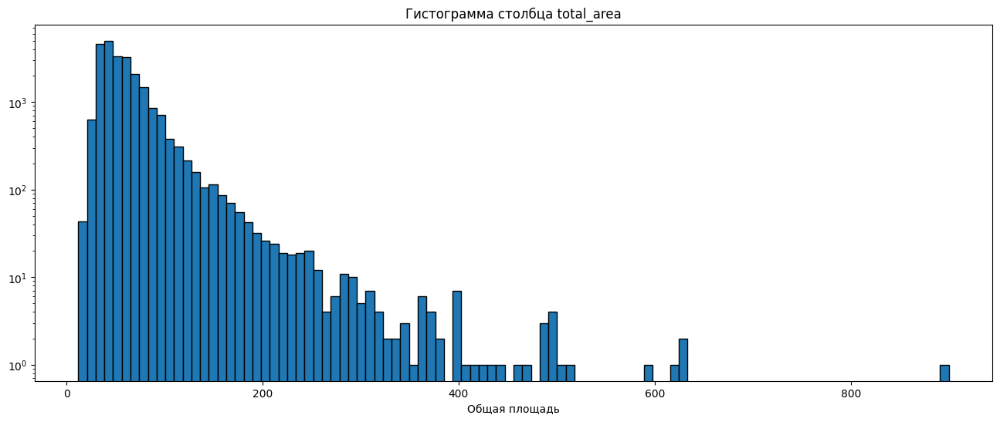

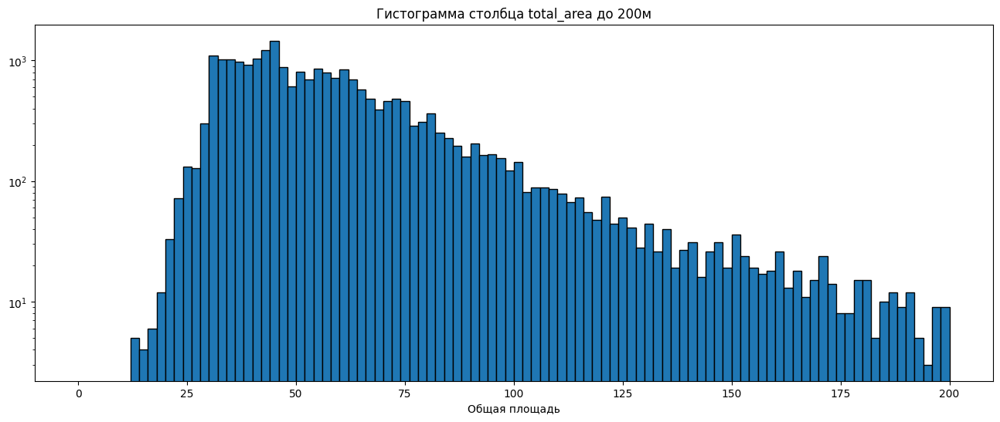

Количество пропусков в столбце total_area: 0

Общая информация о данных в столбце


count    23699.000000
mean        60.348651
std         35.654083
min         12.000000
25%         40.000000
50%         52.000000
75%         69.900000
max        900.000000
Name: total_area, dtype: float64

In [49]:
# Анализ и обработка столбца Общая площадь
plt.figure(figsize=(16, 6))
plt.hist(data['total_area'], bins=100, edgecolor='black', log=True)
plt.xlabel('Общая площадь')
plt.title('Гистограмма столбца total_area')
plt.show()

# Анализ и обработка столбца Общая площадь (более детально)
plt.figure(figsize=(16, 6))
plt.hist(data['total_area'], bins=100, edgecolor='black', log=True, range = (0,200))
plt.xlabel('Общая площадь')
plt.title('Гистограмма столбца total_area до 200м')
plt.show()

total_area_nan_count = data['total_area'].isna().sum()
print('Количество пропусков в столбце total_area:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['total_area'].describe()


В столбце total_area нет пропущенных данных. 
Минимальное значение 12 квадратных метров, максимальное значение 900 квадратных метров. 
Медианное значение 52 квадратных метров, среднее значение 60 квадратных метров. 

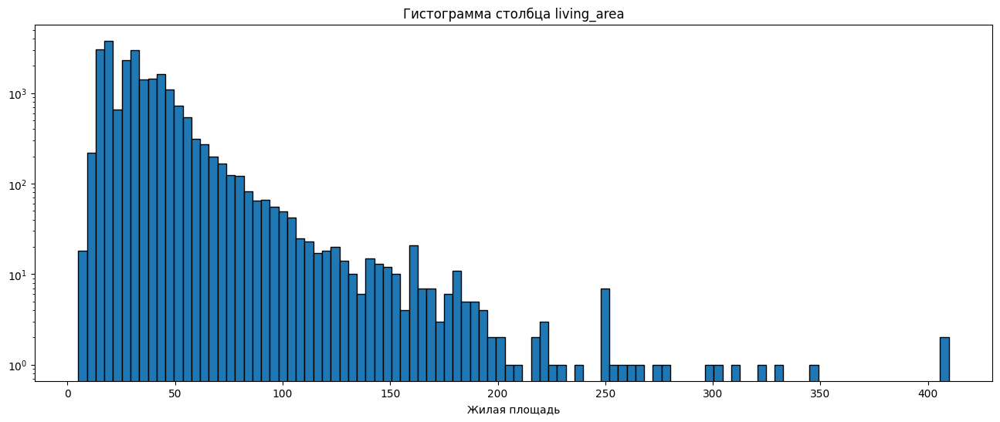

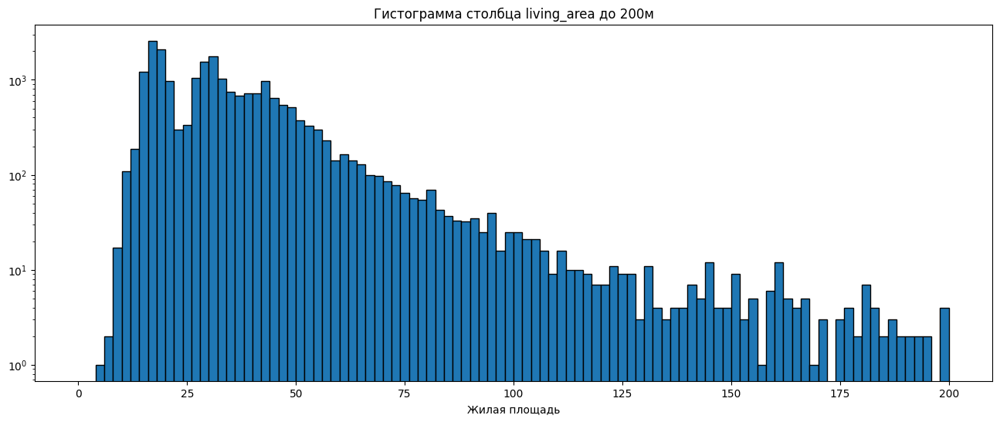

Количество пропусков в столбце living_area: 1904

Общая информация о данных в столбце


count    21795.000000
mean        34.464416
std         22.026668
min          5.000000
25%         18.600000
50%         30.000000
75%         42.300000
max        409.700000
Name: living_area, dtype: float64

In [50]:
# Анализ и обработка столбца Жилая площадь
plt.figure(figsize=(16, 6))
plt.hist(data['living_area'].dropna(), bins=100, edgecolor='black', log=True)
plt.xlabel('Жилая площадь')
plt.title('Гистограмма столбца living_area')
plt.show()

# Анализ и обработка столбца Жилая площадь (более детально)
plt.figure(figsize=(16, 6))
plt.hist(data['living_area'].dropna(), bins=100, edgecolor='black', log=True, range = (0,200))
plt.xlabel('Жилая площадь')
plt.title('Гистограмма столбца living_area до 200м')
plt.show()

total_area_nan_count = data['living_area'].isna().sum()
print('Количество пропусков в столбце living_area:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['living_area'].describe()

В столбце living_area присутствуют пропуски. 
Минимальное значение 5 квадратных метров, максимальное значение 410 квадратных метров. 
Медианное значение 30 квадратных метров, среднее значение 35 квадратных метров. 

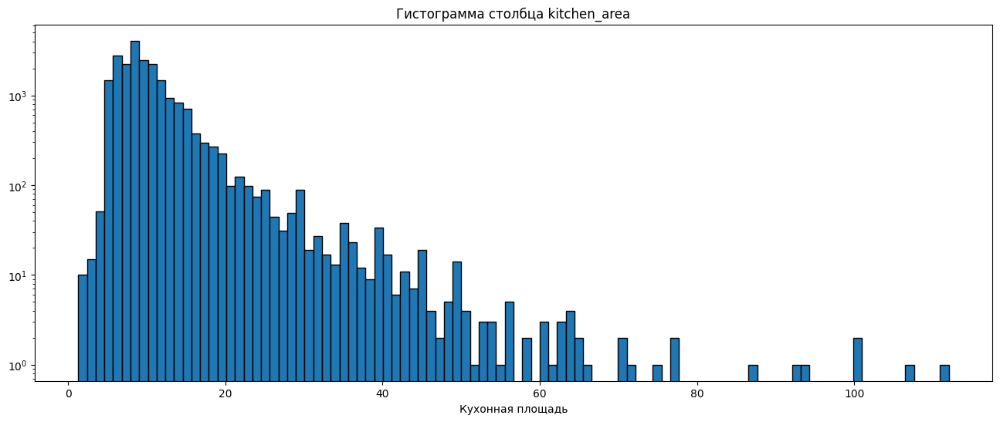

Количество пропусков в столбце kitchen_area: 2278

Общая информация о данных в столбце


count    21421.000000
mean        10.569807
std          5.905438
min          1.300000
25%          7.000000
50%          9.100000
75%         12.000000
max        112.000000
Name: kitchen_area, dtype: float64

In [51]:
# Анализ и обработка столбца Кухонная площадь
plt.figure(figsize=(16, 6))
plt.hist(data['kitchen_area'].dropna(), bins=100, edgecolor='black', log=True)
plt.xlabel('Кухонная площадь')
plt.title('Гистограмма столбца kitchen_area')
plt.show()

total_area_nan_count = data['kitchen_area'].isna().sum()
print('Количество пропусков в столбце kitchen_area:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['kitchen_area'].describe()

В столбце kitchen_area есть пропущенные данные. 
Минимальное значение 1.3 квадратных метров, максимальное значение 112 квадратных метров. 
Медианное значение 9.1 квадратных метров, среднее значение 11 квадратных метров. 

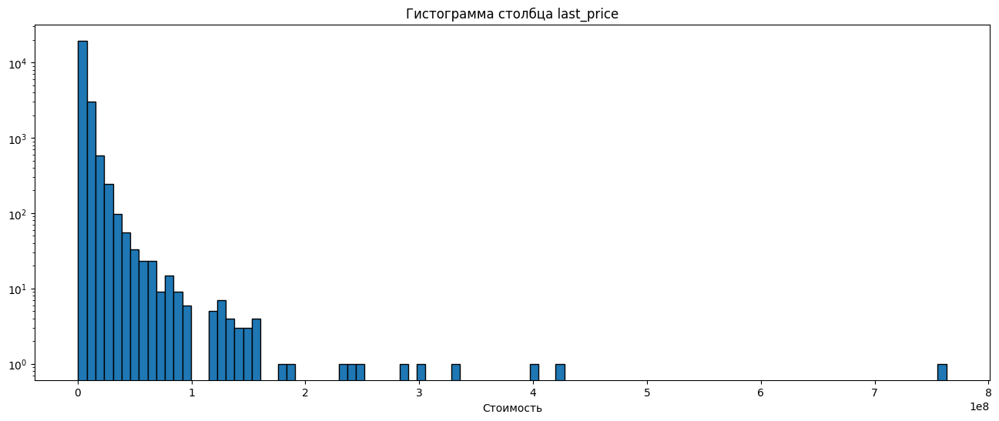

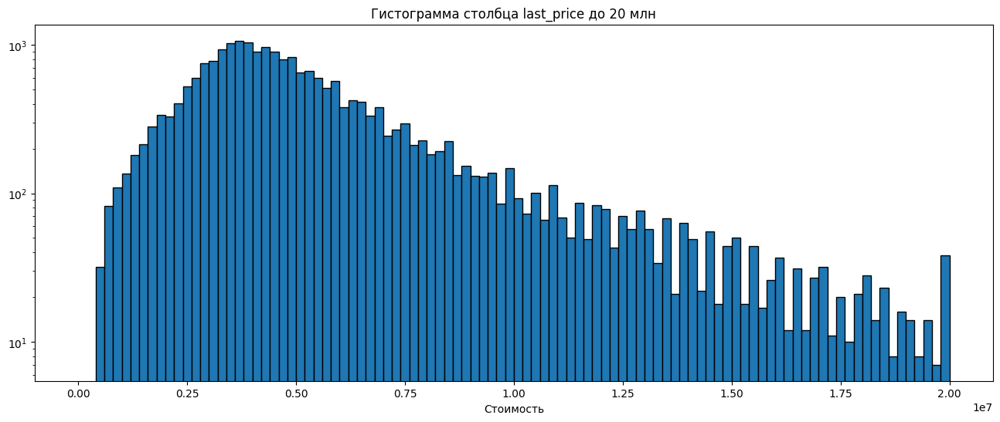

Количество пропусков в столбце last_price: 0

Общая информация о данных в столбце


count    2.369900e+04
mean     6.542063e+06
std      1.088699e+07
min      4.300000e+05
25%      3.400000e+06
50%      4.650000e+06
75%      6.800000e+06
max      7.630000e+08
Name: last_price, dtype: float64

In [52]:
# Анализ и обработка столбца Стоимость
plt.figure(figsize=(16, 6))
plt.hist(data['last_price'].dropna(), bins=100, edgecolor='black', log=True)
plt.xlabel('Стоимость')
plt.title('Гистограмма столбца last_price')
plt.show()

# Анализ и обработка столбца Стоимость (более детально)
plt.figure(figsize=(16, 6))
plt.hist(data['last_price'].dropna(), bins=100, edgecolor='black', log=True, range = (0,20000000))
plt.xlabel('Стоимость')
plt.title('Гистограмма столбца last_price до 20 млн')
plt.show()

total_area_nan_count = data['last_price'].isna().sum()
print('Количество пропусков в столбце last_price:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['last_price'].describe()

В столбце last_price нет пропущенных данных. 
Минимальное значение 430 000 рублей, максимальное значение 736 000 000  рублей. 
Медианное значение 4 650 000 рублей, среднее значение 6 542 000 рублей.  

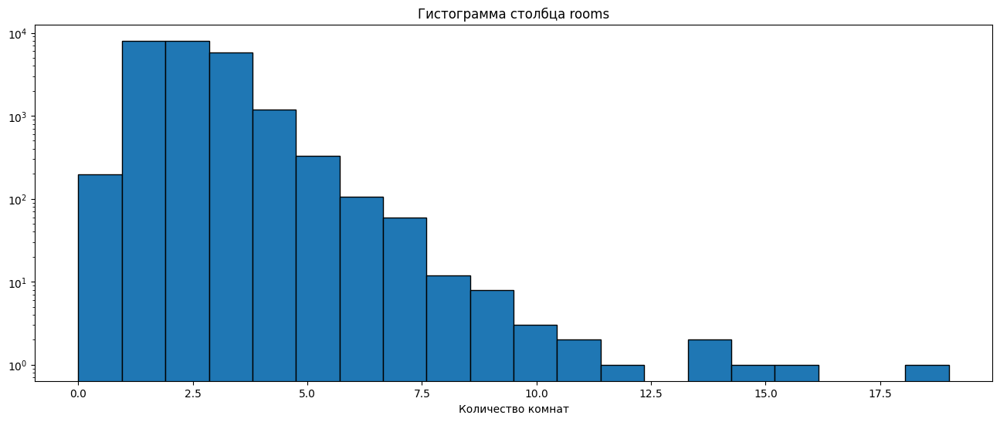

Количество пропусков в столбце rooms: 0

Общая информация о данных в столбце


count    23699.000000
mean         2.070636
std          1.078405
min          0.000000
25%          1.000000
50%          2.000000
75%          3.000000
max         19.000000
Name: rooms, dtype: float64

In [53]:
# Анализ и обработка столбца Количество комнат
plt.figure(figsize=(16, 6))
plt.hist(data['rooms'].dropna(), bins=20, edgecolor='black', log=True)
plt.xlabel('Количество комнат')
plt.title('Гистограмма столбца rooms')
plt.show()

total_area_nan_count = data['rooms'].isna().sum()
print('Количество пропусков в столбце rooms:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['rooms'].describe()

В столбце rooms нет пропущенных данных. 
Минимальное значение 0 комнат, максимальное значение 19 комнат. 
Медианное значение 2 комнаты, среднее значение 2 комнаты. 

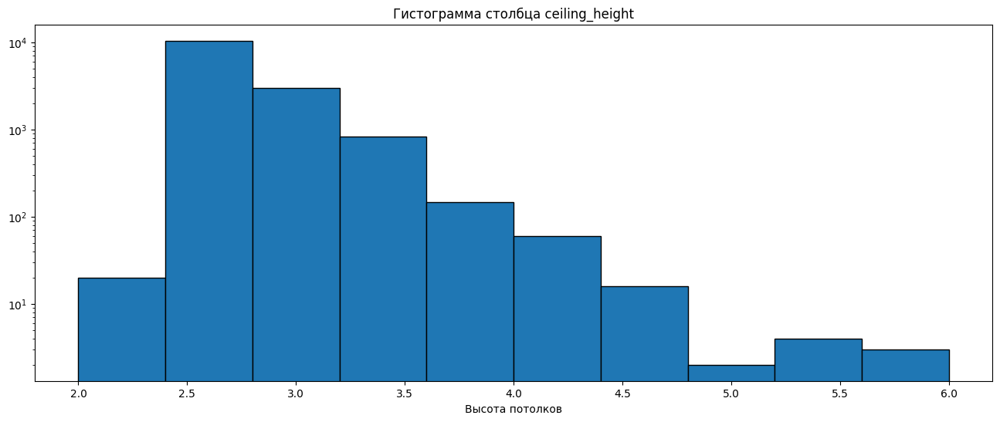

Количество пропусков в столбце ceiling_height: 9205

Общая информация о данных в столбце


count    14494.000000
mean         2.726623
std          0.278702
min          2.000000
25%          2.510000
50%          2.650000
75%          2.800000
max          6.000000
Name: ceiling_height, dtype: float64

In [54]:
# Анализ и обработка столбца Высота потолков
plt.figure(figsize=(16, 6))
plt.hist(data['ceiling_height'].dropna(), bins=10, edgecolor='black', log=True)
plt.xlabel('Высота потолков')
plt.title('Гистограмма столбца ceiling_height')
plt.show()

total_area_nan_count = data['ceiling_height'].isna().sum()
print('Количество пропусков в столбце ceiling_height:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['ceiling_height'].describe()

В столбце ceiling_height есть пропущенные данные. 
Минимальное значение 2 метра, максимальное значение 6 метров. 
Медианное значение 2.65 метра, среднее значение 2.73 метра. 

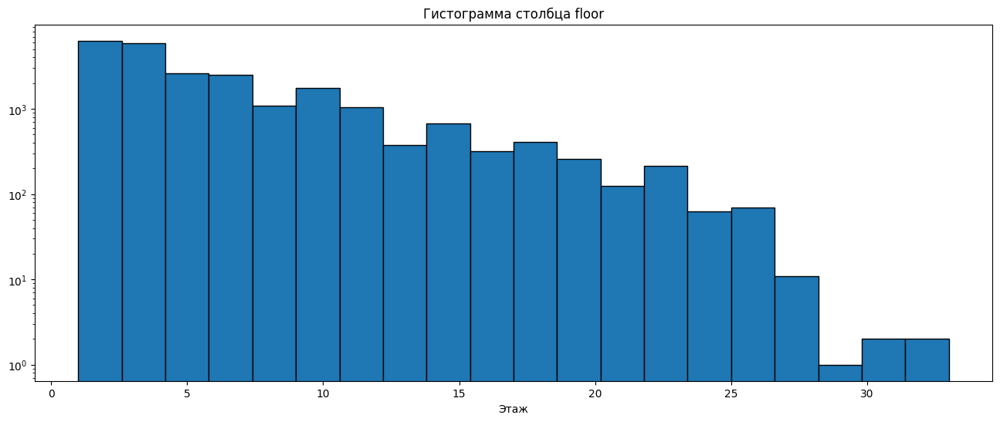

Количество пропусков в столбце floor: 0

Общая информация о данных в столбце


count    23699.000000
mean         5.892358
std          4.885249
min          1.000000
25%          2.000000
50%          4.000000
75%          8.000000
max         33.000000
Name: floor, dtype: float64

In [55]:
# Анализ и обработка столбца Этаж
plt.figure(figsize=(16, 6))
plt.hist(data['floor'].dropna(), bins=20, edgecolor='black', log=True)
plt.xlabel('Этаж')
plt.title('Гистограмма столбца floor')
plt.show()

total_area_nan_count = data['floor'].isna().sum()
print('Количество пропусков в столбце floor:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['floor'].describe()

В столбце floor нет пропущенных данных. 
Минимальное значение 1 этаж, максимальное значение 33 этаж. 
Медианное значение 4 этаж, среднее значение 5.9 этажа. 

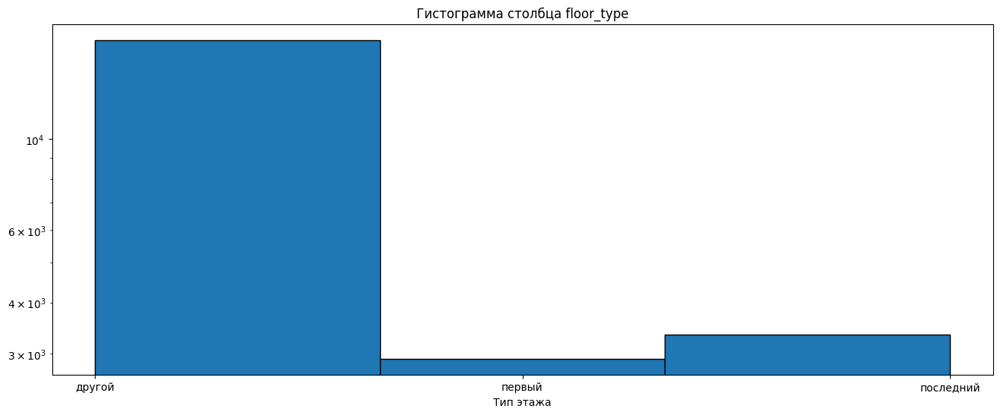

Количество пропусков в столбце floor_type: 0

Общая информация о данных в столбце


count      23699
unique         3
top       другой
freq       17446
Name: floor_type, dtype: object

In [56]:
# Анализ и обработка столбца Тип этажа
plt.figure(figsize=(16, 6))
plt.hist(data['floor_type'].dropna(), bins=3, edgecolor='black', log=True)
plt.xlabel('Тип этажа')
plt.title('Гистограмма столбца floor_type')
plt.show()

total_area_nan_count = data['floor_type'].isna().sum()
print('Количество пропусков в столбце floor_type:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['floor_type'].describe()

В столбце floor_type нет пропущенных данных. 
Абсолютное большинство квартир находятся в категории "Другие" (не первый и не последний этаж).

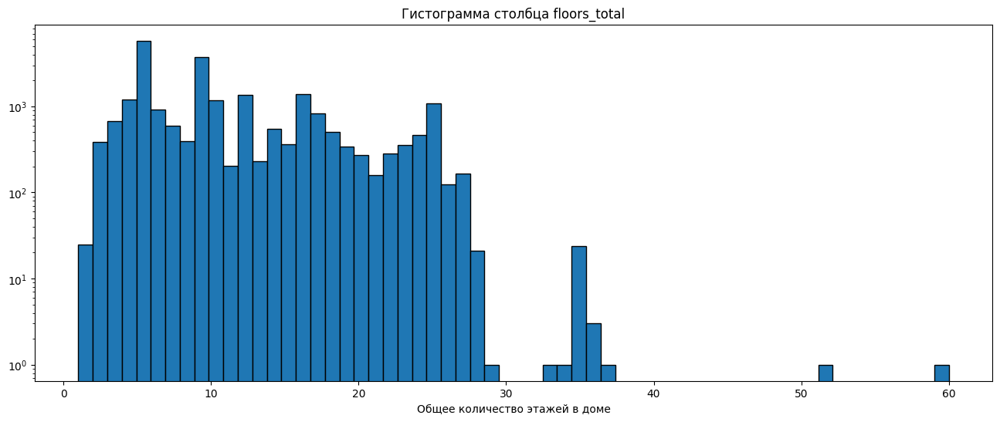

Количество пропусков в столбце floors_total: 86

Общая информация о данных в столбце


count    23613.000000
mean        10.673824
std          6.597173
min          1.000000
25%          5.000000
50%          9.000000
75%         16.000000
max         60.000000
Name: floors_total, dtype: float64

In [57]:
# Анализ и обработка столбца Общее количество этажей в доме
plt.figure(figsize=(16, 6))
plt.hist(data['floors_total'].dropna(), bins=60, edgecolor='black', log=True)
plt.xlabel('Общее количество этажей в доме')
plt.title('Гистограмма столбца floors_total')
plt.show()

total_area_nan_count = data['floors_total'].isna().sum()
print('Количество пропусков в столбце floors_total:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['floors_total'].describe()

В столбце floors_total есть пропущенные данные. 
Минимальное значение 1 этаж, максимальное значение 60 этажей. 
Медианное значение 9 этажей, среднее значение 10.7 этажей. 

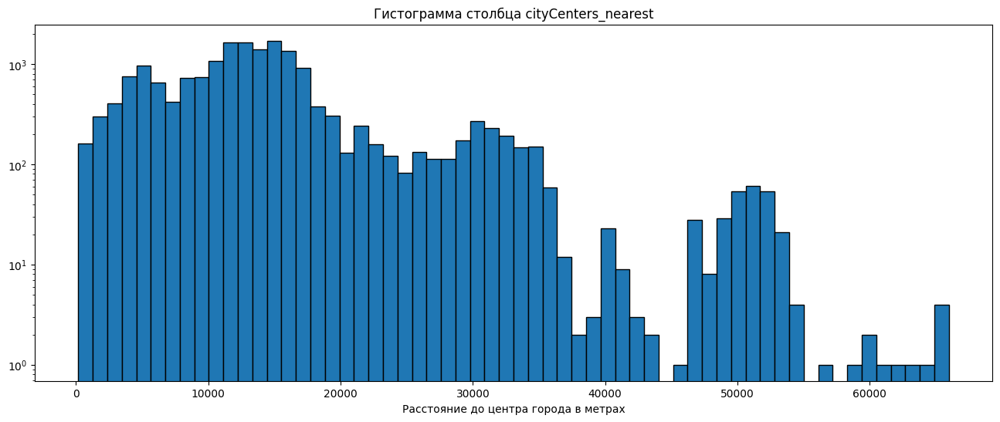

Количество пропусков в столбце cityCenters_nearest: 5519

Общая информация о данных в столбце


count    18180.000000
mean     14191.277833
std       8608.386210
min        181.000000
25%       9238.000000
50%      13098.500000
75%      16293.000000
max      65968.000000
Name: cityCenters_nearest, dtype: float64

In [58]:
# Анализ и обработка столбца Расстояние до центра города в метрах
plt.figure(figsize=(16, 6))
plt.hist(data['cityCenters_nearest'].dropna(), bins=60, edgecolor='black', log=True)
plt.xlabel('Расстояние до центра города в метрах')
plt.title('Гистограмма столбца cityCenters_nearest')
plt.show()

total_area_nan_count = data['cityCenters_nearest'].isna().sum()
print('Количество пропусков в столбце cityCenters_nearest:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['cityCenters_nearest'].describe()

В столбце cityCenters_nearest есть пропущенные данные. 
Минимальное значение 181 метр, максимальное значение 65968 метров. 
Медианное значение 13098 метров, среднее значение 14191 метров. 

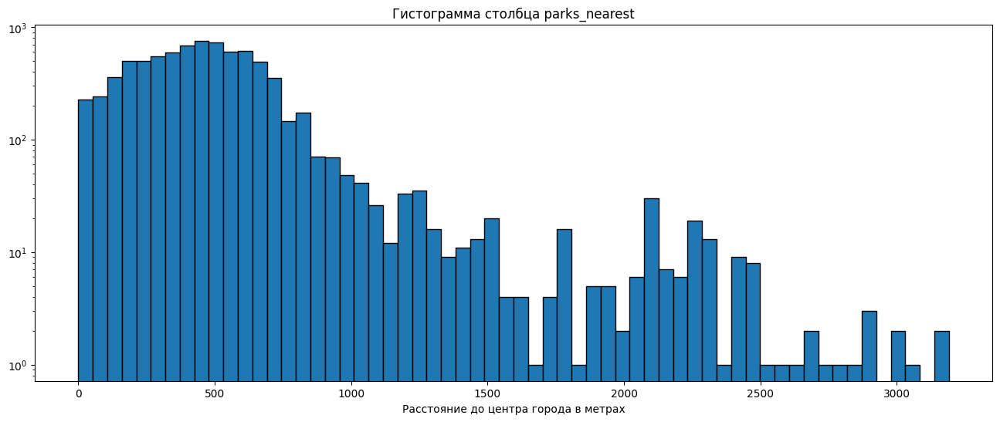

Количество пропусков в столбце parks_nearest: 15620

Общая информация о данных в столбце


count    8079.000000
mean      490.804555
std       342.317995
min         1.000000
25%       288.000000
50%       455.000000
75%       612.000000
max      3190.000000
Name: parks_nearest, dtype: float64

In [59]:
# Анализ и обработка столбца Расстояние до ближайшего парка
plt.figure(figsize=(16, 6))
plt.hist(data['parks_nearest'].dropna(), bins=60, edgecolor='black', log=True)
plt.xlabel('Расстояние до центра города в метрах')
plt.title('Гистограмма столбца parks_nearest')
plt.show()

total_area_nan_count = data['parks_nearest'].isna().sum()
print('Количество пропусков в столбце parks_nearest:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['parks_nearest'].describe()

В столбце parks_nearest есть пропущенные данные. 
Минимальное значение 1 метр, максимальное значение 3190 метров. 
Медианное значение 455 метров, среднее значение 491 метр. 

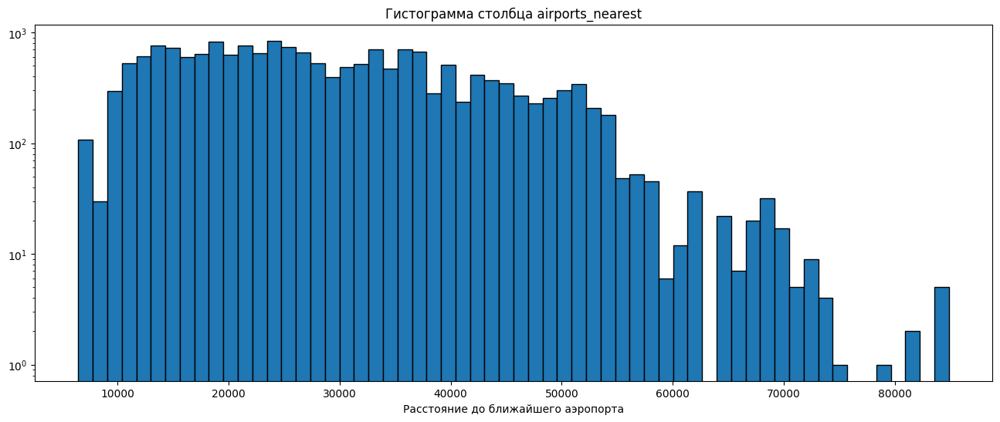

Количество пропусков в столбце airports_nearest: 5543

Общая информация о данных в столбце


count    18156.000000
mean     28795.258096
std      12629.420568
min       6450.000000
25%      18585.000000
50%      26726.000000
75%      37273.500000
max      84869.000000
Name: airports_nearest, dtype: float64

In [60]:
# Анализ и обработка столбца Расстояние до ближайшего аэропорта
plt.figure(figsize=(16, 6))
plt.hist(data['airports_nearest'].dropna(), bins=60, edgecolor='black', log=True)
plt.xlabel('Расстояние до ближайшего аэропорта')
plt.title('Гистограмма столбца airports_nearest')
plt.show()

total_area_nan_count = data['airports_nearest'].isna().sum()
print('Количество пропусков в столбце airports_nearest:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['airports_nearest'].describe()

В столбце airports_nearest есть пропущенные данные. 
Минимальное значение 6450 метров, максимальное значение 84869 метров. 
Медианное значение 26726 метров, среднее значение 28795 метров. 

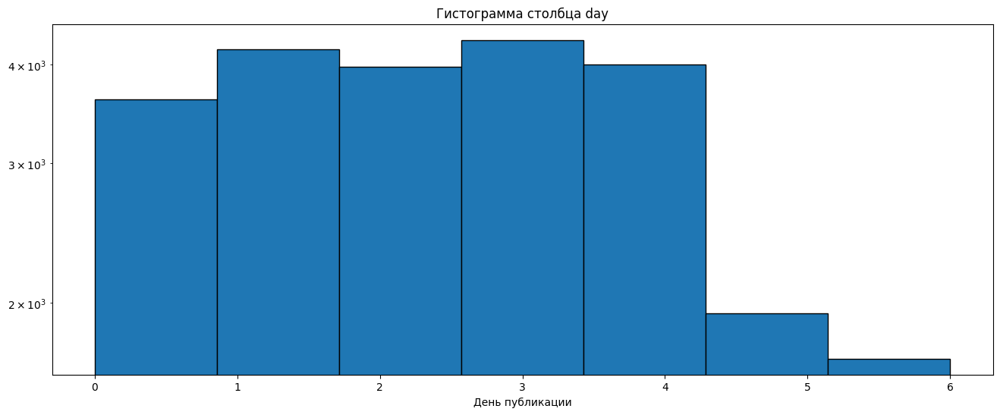

Количество пропусков в столбце day: 0

Общая информация о данных в столбце


count    23699.000000
mean         2.569307
std          1.789082
min          0.000000
25%          1.000000
50%          3.000000
75%          4.000000
max          6.000000
Name: day, dtype: float64

In [61]:
# Анализ и обработка столбца День публикации
plt.figure(figsize=(16, 6))
plt.hist(data['day'].dropna(), bins=7, edgecolor='black', log=True)
plt.xlabel('День публикации')
plt.title('Гистограмма столбца day')
plt.show()

total_area_nan_count = data['day'].isna().sum()
print('Количество пропусков в столбце day:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['day'].describe()

В столбце day нет пропущенных данных. 
Минимальное значение 0 (Пн), максимальное значение 6 (Вс). 
Медианное значение 3 (Чт), среднее значение 2.6 (Ср-Чт). 

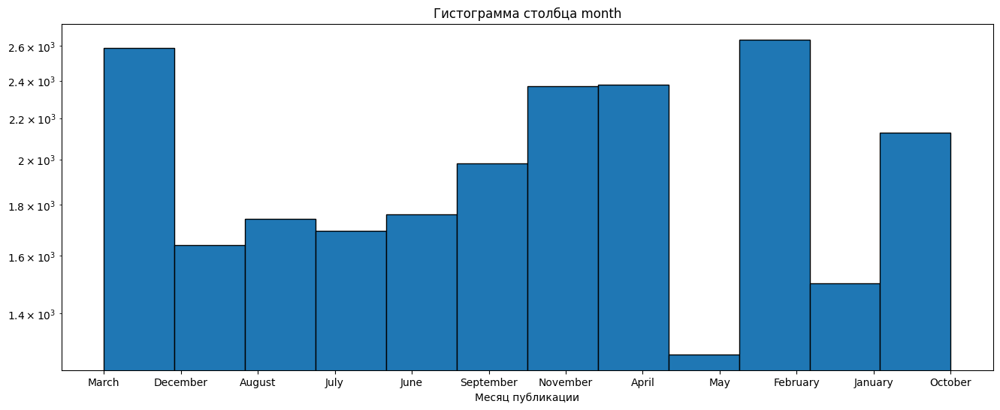

Количество пропусков в столбце month: 0

Общая информация о данных в столбце


count        23699
unique          12
top       February
freq          2640
Name: month, dtype: object

In [62]:
# Анализ и обработка столбца Месяц публикации
plt.figure(figsize=(16, 6))
plt.hist(data['month'].dropna(), bins=12, edgecolor='black', log=True)
plt.xlabel('Месяц публикации')
plt.title('Гистограмма столбца month')
plt.show()

total_area_nan_count = data['month'].isna().sum()
print('Количество пропусков в столбце month:', total_area_nan_count)
print()
print('Общая информация о данных в столбце')
data['month'].describe()

В столбце month нет пропущенных данных. 
В данных 12 месяцев, наиболее частые продажи в феврале, наиболее редкие в мае.

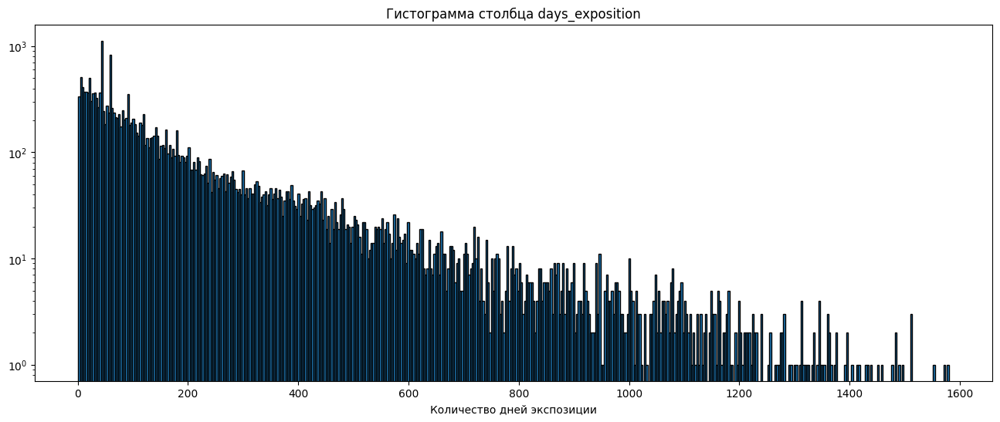

Количество пропусков в столбце days_exposition: 3181
Среднее количество дней экспозции 180.88863436982163
Медианное количество дней экспозции 95.0

Общая информация о данных в столбце


count    20518.000000
mean       180.888634
std        219.727988
min          1.000000
25%         45.000000
50%         95.000000
75%        232.000000
max       1580.000000
Name: days_exposition, dtype: float64

In [63]:
# Анализ и обработка столбца Количество дней экспозиции
plt.figure(figsize=(16, 6))
plt.hist(data['days_exposition'].dropna(), bins=500, edgecolor='black', log=True)
plt.xlabel('Количество дней экспозиции')
plt.title('Гистограмма столбца days_exposition')
plt.show()

total_area_nan_count = data['days_exposition'].isna().sum()
print('Количество пропусков в столбце days_exposition:', total_area_nan_count)

print('Среднее количество дней экспозции', data['days_exposition'].mean())
print('Медианное количество дней экспозции', data['days_exposition'].median())
print()
print('Общая информация о данных в столбце')
data['days_exposition'].describe()


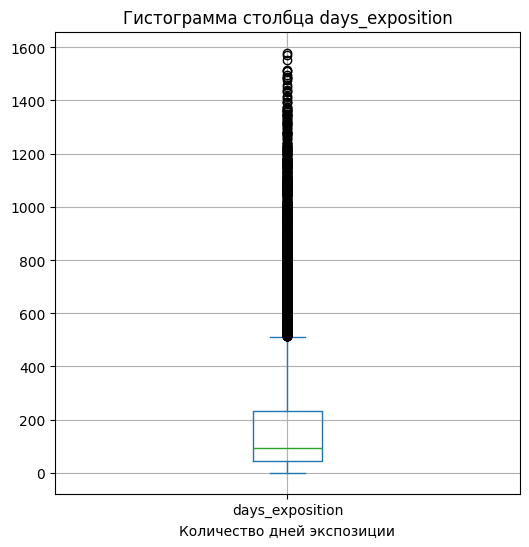

25th Percentile (Q1): 45.00000000000001
50th Percentile (Median): 95.0
75th Percentile (Q3): 232.0
Нижняя граница редких выбросов: -235.5
Верхняя граница редких выбросов: 512.5


In [64]:
# Анализ и обработка столбца Количество дней экспозиции
plt.figure(figsize=(6, 6))
data['days_exposition'].plot(kind='box', grid = True)
plt.xlabel('Количество дней экспозиции')
plt.title('Гистограмма столбца days_exposition')
plt.show()


percentile_25 = data['days_exposition'].quantile(0.25)  # 25th percentile (Q1)
percentile_50 = data['days_exposition'].quantile(0.50)  # 50th percentile (median)
percentile_75 = data['days_exposition'].quantile(0.75)  # 75th percentile (Q3)

IQR = percentile_75 - percentile_25
Lower_whisker = percentile_25 - IQR * 1.5
Higher_whisker = percentile_75 + IQR * 1.5

print("25th Percentile (Q1):", percentile_25)
print("50th Percentile (Median):", percentile_50)
print("75th Percentile (Q3):", percentile_75)
print("Нижняя граница редких выбросов:", Lower_whisker)
print("Верхняя граница редких выбросов:", Higher_whisker)


В столбце days_exposition есть пропущенные данные. 
Минимальное значение 1 день, максимальное значение 1580 дней. 
Медианное значение 95 дней, среднее значение 181 день. 

Согласно типовому расчету и характеру распределения значений в гистограмме, особенно *быстрых значений* не существует, поскольку в норме продажа происходит быстро, *необычно долгими* можно принять продажи дольше 513 дней. 

Среднее время экпозиции объявления составляет 181 день, медианное значение - 95 дней.


In [65]:

display(data.pivot_table(index='rooms', values='last_price', aggfunc=['median', 'count']))

display(data.pivot_table(index='floor_type', values='last_price', aggfunc=['median', 'count']))

display(data.pivot_table(index='day', values='last_price', aggfunc=['median', 'count']))

display(data.pivot_table(index='month', values='last_price', aggfunc=['median', 'count']))

display(data.pivot_table(index='year', values='last_price', aggfunc=['median', 'count']))

,median,count
,last_price,last_price
rooms,,
0,2700000.0,197
1,3600000.0,8047
2,4772669.0,7940
3,6200000.0,5814
4,9000000.0,1180
5,14000000.0,326
6,19000000.0,105
7,24900000.0,59


,median,count
,last_price,last_price
floor_type,,
другой,4850000.0,17446
первый,3900000.0,2917
последний,4300000.0,3336


,median,count
,last_price,last_price
day,,
0,4650000.0,3612
1,4730000.0,4183
2,4700000.0,3974
3,4650000.0,4295
4,4585000.0,4000
5,4555000.0,1936
6,4550000.0,1699


,median,count
,last_price,last_price
month,,
April,4800000.0,2379
August,4570000.0,1744
December,4700000.0,1641
February,4650000.0,2640
January,4600000.0,1500
July,4650000.0,1695
June,4400000.0,1760
March,4650000.0,2587


,median,count
,last_price,last_price
year,,
2014,7700000.0,137
2015,5350000.0,1191
2016,4550000.0,2783
2017,4500000.0,8190
2018,4550000.0,8519
2019,5050000.0,2879


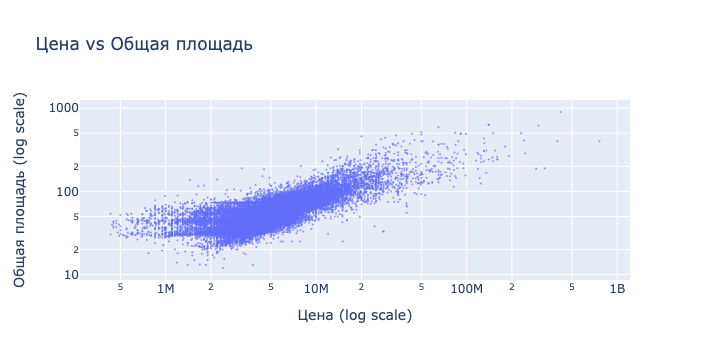

Коэффициент корреляции между ценой и площадью: 0.6537407142641286


In [66]:
# Scatter график Цена vs Общая площадь

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['last_price'], 
    y=data['total_area'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')
fig.update_layout(
    title='Цена vs Общая площадь',
    xaxis_title='Цена (log scale)',
    yaxis_title='Общая площадь (log scale)'
)
fig.show()

correlation = data['last_price'].corr(data['total_area'])

print("Коэффициент корреляции между ценой и площадью:", correlation)

Цена и площадь квартиры имеют устойчивую положительную корреляцию, коэффициент корреляции 0.65. 

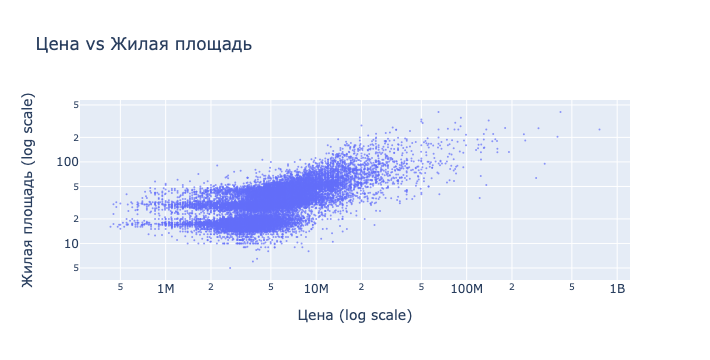

Коэффициент корреляции между ценой и жилой площадью: 0.5672975866604889


In [67]:
# Scatter график Цена vs Жилая площадь

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['last_price'], 
    y=data['living_area'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')
fig.update_layout(
    title='Цена vs Жилая площадь',
    xaxis_title='Цена (log scale)',
    yaxis_title='Жилая площадь (log scale)'
)
fig.show()

correlation = data['last_price'].corr(data['living_area'])

print("Коэффициент корреляции между ценой и жилой площадью:", correlation)


Цена и жилая площадь квартиры имеют устойчивую положительную корреляцию, коэффициент корреляции 0.57. 

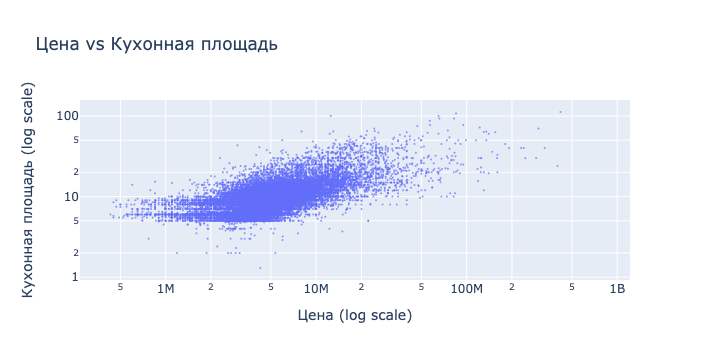

Коэффициент корреляции между ценой и кухонной площадью: 0.5201666399417327


In [68]:
# Scatter график Цена vs Кухонная площадь

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['last_price'], 
    y=data['kitchen_area'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_yaxes(type='log')
fig.update_layout(
    title='Цена vs Кухонная площадь',
    xaxis_title='Цена (log scale)',
    yaxis_title='Кухонная площадь (log scale)'
)
fig.show()

correlation = data['last_price'].corr(data['kitchen_area'])

print("Коэффициент корреляции между ценой и кухонной площадью:", correlation)


Цена и кухонная площадь квартиры имеют устойчивую положительную корреляцию, коэффициент корреляции 0.52. 

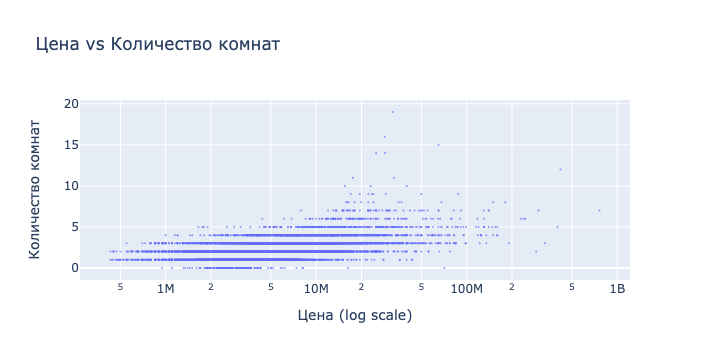

Коэффициент корреляции между ценой и количеством комнат: 0.3633404525374846


In [69]:
# Scatter график Цена vs Количество комнат

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['last_price'], 
    y=data['rooms'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_layout(
    title='Цена vs Количество комнат',
    xaxis_title='Цена (log scale)',
    yaxis_title='Количество комнат'
)
fig.show()

correlation = data['last_price'].corr(data['rooms'])

print("Коэффициент корреляции между ценой и количеством комнат:", correlation)


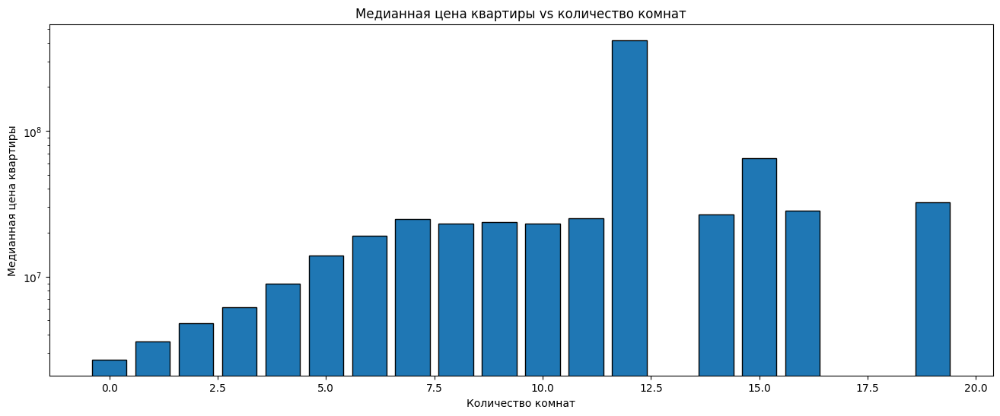

In [70]:
# Столбчатая диаграмма Цена vs Количество комнат
plt.figure(figsize=(16, 6))
plt.bar(data.pivot_table(index='rooms', values='last_price', aggfunc=['median']).index, 
        data.pivot_table(index='rooms', values='last_price', aggfunc=['median'])[('median', 'last_price')], 
        edgecolor='black', 
        log=True)
plt.xlabel('Количество комнат')
plt.ylabel('Медианная цена квартиры')
plt.title('Медианная цена квартиры vs количество комнат')
plt.show()


Цена и количество комнат в квартире имеют устойчивую положительную корреляцию, коэффициент корреляции 0.36. Корреляция слабее, чем между ценой и площадью квартиры, тем не менее она видна на графике.

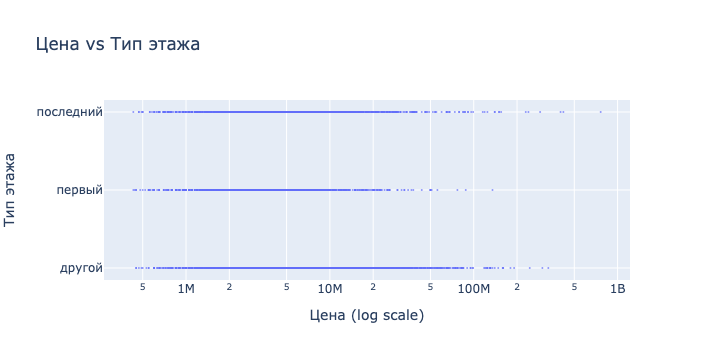

In [71]:
# Scatter график Цена vs Тип этажа

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['last_price'], 
    y=data['floor_type'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_layout(
    title='Цена vs Тип этажа',
    xaxis_title='Цена (log scale)',
    yaxis_title='Тип этажа'
)
fig.show()

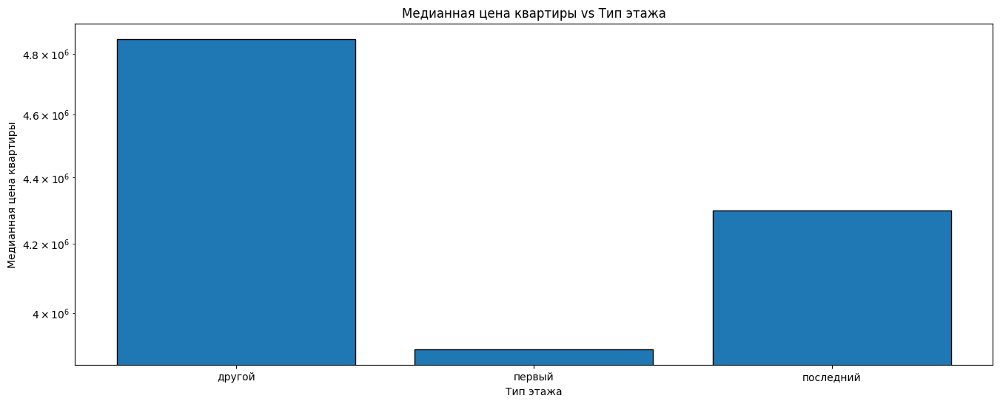

In [72]:
# Столбчатая диаграмма Цена vs Тип этажа
plt.figure(figsize=(16, 6))
plt.bar(data.pivot_table(index='floor_type', values='last_price', aggfunc=['median']).index, 
        data.pivot_table(index='floor_type', values='last_price', aggfunc=['median'])[('median', 'last_price')], 
        edgecolor='black', 
        log=True)
plt.xlabel('Тип этажа')
plt.ylabel('Медианная цена квартиры')
plt.title('Медианная цена квартиры vs Тип этажа')
plt.show()

Из сводной таблицы и графика заметно, что медианное значение цены квартир из категории Другие (4 850 000 рублей) выше, чем у всех остальных, а у категории Последний (4 300 000 рублей) выше, чем у категории Первый (3 900 000 рублей).

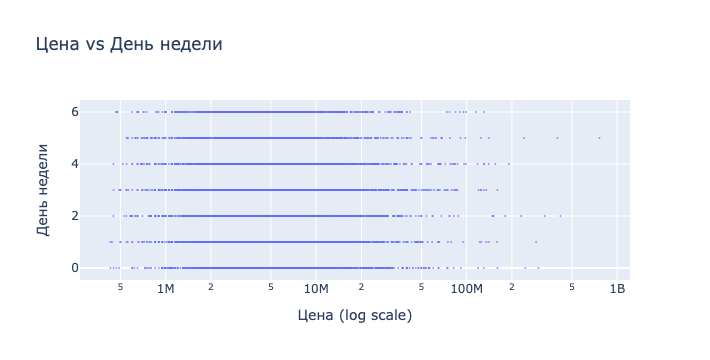

In [73]:
# Scatter график Цена vs День недели

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['last_price'], 
    y=data['day'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_layout(
    title='Цена vs День недели',
    xaxis_title='Цена (log scale)',
    yaxis_title='День недели'
)
fig.show()

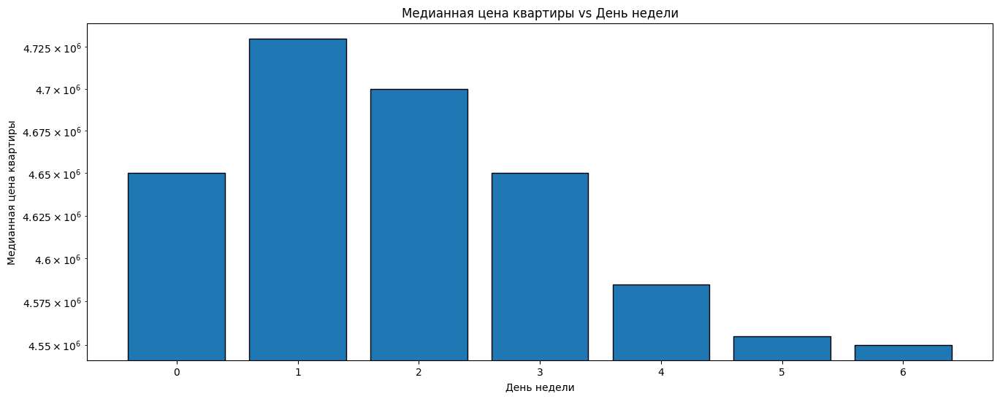

In [74]:
# Столбчатая диаграмма Цена vs День недели
plt.figure(figsize=(16, 6))
plt.bar(data.pivot_table(index='day', values='last_price', aggfunc=['median']).index, 
        data.pivot_table(index='day', values='last_price', aggfunc=['median'])[('median', 'last_price')], 
        edgecolor='black', 
        log=True)
plt.xlabel('День недели')
plt.ylabel('Медианная цена квартиры')
plt.title('Медианная цена квартиры vs День недели')
plt.show()

Не наблюдается сильное влияние дня недели публикации на цену квартиры (менее 5%), наменьшее медианное значение достигается в Вс (4 500 000), наибольшее медианное значение во Вт (4 730 000).

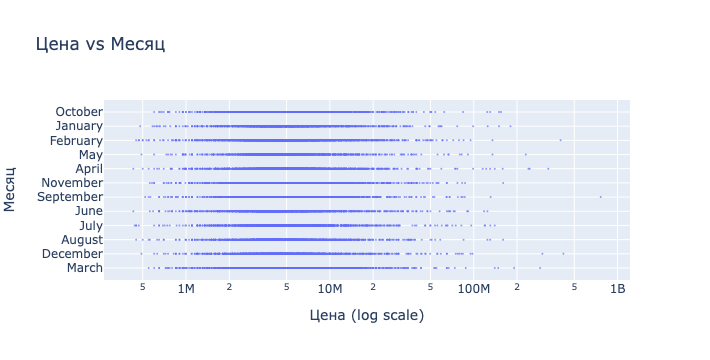

In [75]:
# Scatter график Цена vs Месяц

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['last_price'], 
    y=data['month'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_layout(
    title='Цена vs Месяц',
    xaxis_title='Цена (log scale)',
    yaxis_title='Месяц'
)
fig.show()

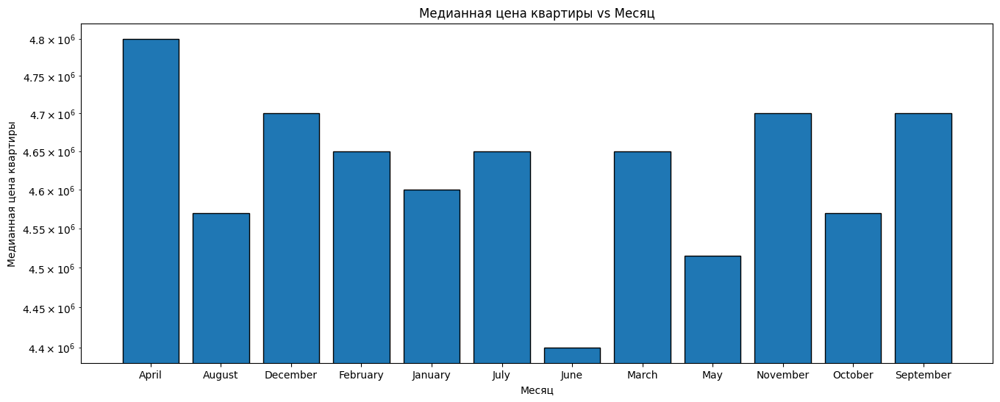

In [76]:
# Столбчатая диаграмма Цена vs Месяц
plt.figure(figsize=(16, 6))
plt.bar(data.pivot_table(index='month', values='last_price', aggfunc=['median']).index, 
        data.pivot_table(index='month', values='last_price', aggfunc=['median'])[('median', 'last_price')], 
        edgecolor='black', 
        log=True)
plt.xlabel('Месяц')
plt.ylabel('Медианная цена квартиры')
plt.title('Медианная цена квартиры vs Месяц')
plt.show()

Не наблюдается значительного влияния сезонности на стоимость квартиры, отклонение от среднегодового медианного значения (4 650 000) не превышает 6%: наименьшее значение в июне (4 400 000), наибольшее значение в апреле (4 800 000). 

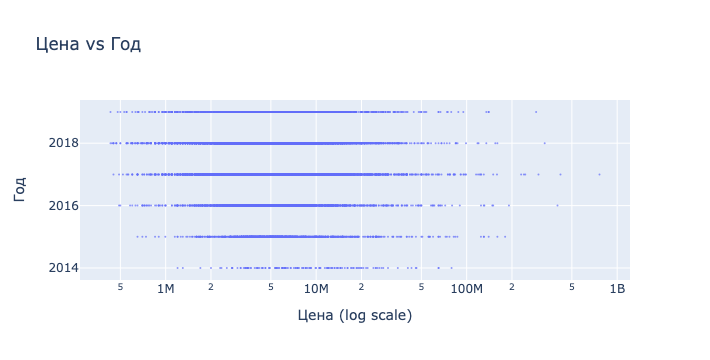

In [77]:
# Scatter график Цена vs Год

fig = go.Figure()

fig.add_trace(go.Scatter(
    x=data['last_price'], 
    y=data['year'], 
    mode='markers',
    marker=dict(size=2, opacity=0.7)
))
fig.update_xaxes(type='log')
fig.update_layout(
    title='Цена vs Год',
    xaxis_title='Цена (log scale)',
    yaxis_title='Год'
)
fig.show()

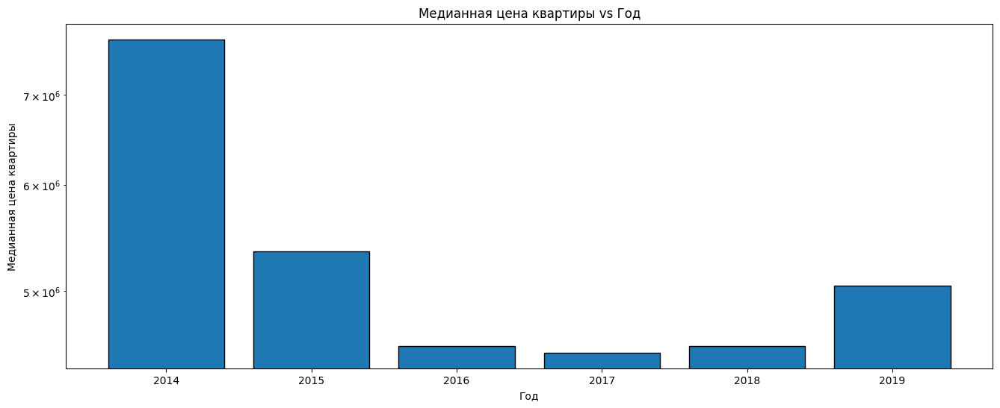

In [78]:
# Столбчатая диаграмма Цена vs Год
plt.figure(figsize=(16, 6))
plt.bar(data.pivot_table(index='year', values='last_price', aggfunc=['median']).index, 
        data.pivot_table(index='year', values='last_price', aggfunc=['median'])[('median', 'last_price')], 
        edgecolor='black', 
        log=True)
plt.xlabel('Год')
plt.ylabel('Медианная цена квартиры')
plt.title('Медианная цена квартиры vs Год')
plt.show()

В 2014 и 2015 годах квартиры имели самую высокую среднюю цену (7700000 и 5350000 рублей, соответственно), при этом в выборку попало всего 137 квартир из 2014 года и можно говорить о статистической незначимости этого года. В 2016-2018 годах средние цены упали до диапазона 4500000...4550000 рублей и менялись менее, чем на 2%. В 2019 году цены выросли на 10% по сравнению с 2018 годом.


Установлена положительная устойчивая корреляция между ценой квартиры и общей площадью квартиры. 

Установлена положительная устойчивая корреляция между ценой квартиры и жилой площадью квартиры. 

Установлена положительная устойчивая корреляция между ценой квартиры и кухонной площадью квартиры. 

Установлена положительная корреляция между ценой квартиры и количеством комнат. Для квартир с большой комнтантностью (более 5 комнат) количество данных статистически не значимо, тем не менее, можно утверждать о наличии положительной корреляции.

Квартиры, расположенные на первом этаже, имеют более низкие цены, нежели все остальные квартиры. Расположение квартиры на последнем этаже также снижает цену, но меньше, чем расположение на первом этаже.

День публикации объявления о продаже практически не оказывает влияния на цену квартиры (разница менее 5% в пределах недели). 

Сезонность публикации имеет очень слабое влияние на цену квартиру (отклонение не более 5% от среднегодовой стоимости): самая низкая цена у июньских объявлений, самая высокая стоимость - у апрельских.

В 2014 и 2015 годах квартиры имели самую высокую среднюю цену (7700000 и 5350000 рублей, соответственно), при этом в выборку попало всего 137 квартир из 2014 года и можно говорить о статистической незначимости этого года. В 2016-2018 годах средние цены упали до диапазона 4500000...4550000 рублей и менялись менее, чем на 2%. В 2019 году цены выросли на 10% по сравнению с 2018 годом.


Расчет средней цены одного квадратного метра в 10 населённых пунктах с наибольшим числом объявлений. Поиск населённых пунктов с самой высокой и низкой стоимостью квадратного метра. 

In [79]:
display(data.pivot_table(index='locality_name', values='meter_price', aggfunc=['count', 'mean']).sort_values(by = ('count', 'meter_price'), ascending = False).head(10))


print('Среднее значение квадратного метра в 10 населённых пунктах с наибольшим числом объявлений:', 
      data.pivot_table(index='locality_name', values='meter_price', aggfunc=['count', 'mean']).sort_values(by = ('count', 'meter_price'), ascending = False)[('mean', 'meter_price')].head(10).mean())

                                           
print()
display(data.pivot_table(index='locality_name', values='meter_price', aggfunc=['count', 'mean']).sort_values(by = ('mean', 'meter_price'), ascending = False))
print('Населённый пункт с самой высокой стоимостью квадратного метра:',  
    data.pivot_table(index='locality_name', values='meter_price', aggfunc=['count', 'mean']).sort_values(by = ('mean', 'meter_price'), ascending = False).index[0])


print()
display(data.pivot_table(index='locality_name', values='meter_price', aggfunc=['count', 'mean']).sort_values(by = ('mean', 'meter_price'), ascending = True))
print('Населённый пункт с самой низкой стоимостью квадратного метра:',
    data.pivot_table(index='locality_name', values='meter_price', aggfunc=['count', 'mean']).sort_values(by = ('mean', 'meter_price'), ascending = True).index[0])
                                           

,count,mean
,meter_price,meter_price
locality_name,,
Санкт-Петербург,15721,114856.115405
посёлок Мурино,590,86087.512050
деревня Кудрово,472,95324.930544
посёлок Шушары,440,78677.364217
Всеволожск,398,68654.473986
Пушкин,369,103125.819291
Колпино,338,75424.579098
посёлок Парголово,327,90175.913458


Среднее значение квадратного метра в 10 населённых пунктах с наибольшим числом объявлений: 83921.47639644594



,count,mean
,meter_price,meter_price
locality_name,,
Зеленогорск,24,115122.799198
Санкт-Петербург,15721,114856.115405
посёлок Репино,4,104238.614786
Пушкин,369,103125.819291
Сестрорецк,183,101757.616875
...,...,...
посёлок Совхозный,2,12629.129129
деревня Выскатка,2,12335.480902


Населённый пункт с самой высокой стоимостью квадратного метра: Зеленогорск



,count,mean
,meter_price,meter_price
locality_name,,
деревня Старополье,3,11206.221198
посёлок станции Свирь,2,11481.481481
деревня Вахнова Кара,1,11688.311688
деревня Выскатка,2,12335.480902
посёлок Совхозный,2,12629.129129
...,...,...
Сестрорецк,183,101757.616875
Пушкин,369,103125.819291


Населённый пункт с самой низкой стоимостью квадратного метра: деревня Старополье


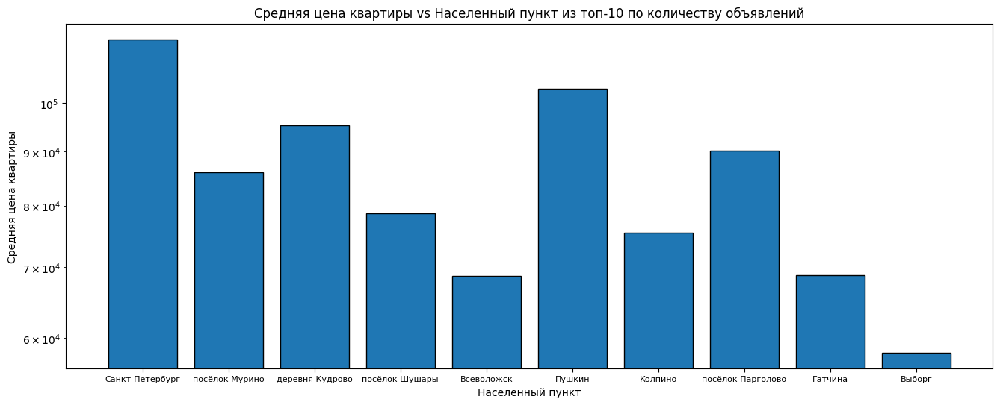

In [80]:
# Столбчатая диаграмма Средняя цена квадратного метра vs Населенный пункт из топ-10 по количеству объявлений
plt.figure(figsize=(16, 6))
plt.bar(data.pivot_table(index='locality_name', values='meter_price', aggfunc=['count', 'mean']).sort_values(by = ('count', 'meter_price'), ascending = False).head(10).index, 
        data.pivot_table(index='locality_name', values='meter_price', aggfunc=['count', 'mean']).sort_values(by = ('count', 'meter_price'), ascending = False).head(10)[('mean', 'meter_price')],
        edgecolor='black', 
        log=True)
plt.xlabel('Населенный пункт')
plt.ylabel('Средняя цена квартиры')
plt.title('Средняя цена квартиры vs Населенный пункт из топ-10 по количеству объявлений')
plt.xticks(fontsize=8)
plt.show()

# использовал средние значения, а не медианные, т.к. в задании написаны средние - можно легко исправить на медианы одним аргументом


Расчет средней цены каждого километра удаленности квартиры в Санкт-Петербурге от центра города. 

In [81]:
sliced = data.query('locality_name == "Санкт-Петербург"')[['last_price', 'cityCenters_nearest_km']]
sliced_pivot = sliced.pivot_table(index = 'cityCenters_nearest_km', values = 'last_price', aggfunc = ['mean', 'count'])
sliced_pivot.head(40)


,mean,count
,last_price,last_price
cityCenters_nearest_km,,
0.0,3.144912e+07,27
1.0,2.120672e+07,192
2.0,1.778832e+07,310
3.0,1.112658e+07,350
4.0,1.330428e+07,688
5.0,1.449912e+07,920
6.0,1.533842e+07,618
7.0,1.477515e+07,420


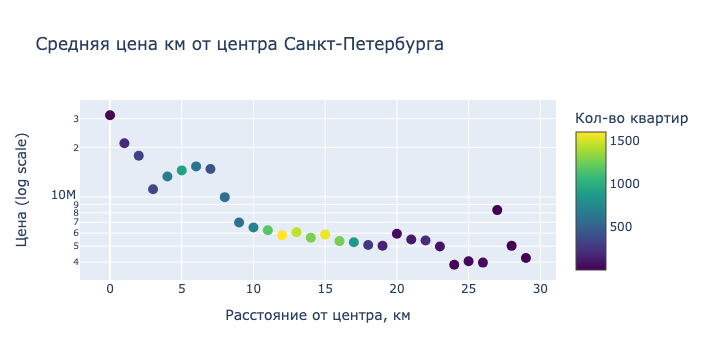

In [82]:
# Scatter график Средняя цена км от центра Санкт-Петербурга

fig = go.Figure()

fig.add_trace(go.Scatter(y = sliced_pivot[('mean', 'last_price')], x=sliced_pivot.index, 
                         mode='markers', 
                         marker=dict(
        size=10,
        color=sliced_pivot[('count', 'last_price')],  
        colorscale='Viridis',   
        colorbar=dict(title='Кол-во квартир')
                         )))
fig.update_yaxes(type='log')
fig.update_layout(
    title='Средняя цена км от центра Санкт-Петербурга',
    yaxis_title='Цена (log scale)',
    xaxis_title='Расстояние от центра, км'
)
fig.show()


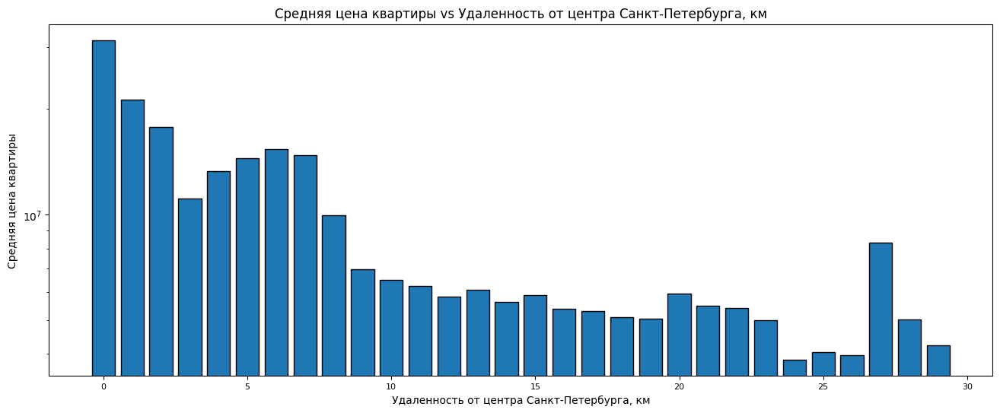

In [83]:
# Столбчатая диаграмма Средняя цена км от центра Санкт-Петербурга
plt.figure(figsize=(16, 6))
plt.bar(sliced_pivot[('mean', 'last_price')].index, 
        sliced_pivot[('mean', 'last_price')],
        edgecolor='black', 
        log=True)
plt.xlabel('Удаленность от центра Санкт-Петербурга, км')
plt.ylabel('Средняя цена квартиры')
plt.title('Средняя цена квартиры vs Удаленность от центра Санкт-Петербурга, км')
plt.xticks(fontsize=8)
plt.show()


Закономерно, чем дальше квартира от центра Санкт-Петербурга, тем дешевле она стоит в среднем. Для расстояний более 26км от центра количество объявлений статистически не значимо.

## Общий вывод

Датасет от Яндекс.Недвижимость содержал 23699 записей об объявлениях о продаже квартир с 2014 по 2019 год. В датасете 28 столбцов с данными, включая цену, дату публикации, площадь, населенный пункт и прочее. 

В ходе предварительной обработки данных были заполнены некоторые пропуски (например, столбец studio) и устранены аномалии (например, столбец о высоте потолков и стоимости). Были изменены типы данных некоторых столбцов. Исправлены неявные дубликаты названий населенных пунктов.

Добавлены несколько столбцов: цена квадратного метра, тип этажа (первый, последний, другие), день, месяц и год публикации и удаленность от центра.

Статистически проанализирован ряд параметров и их взаимосвязь между собой. 
Проведено исследование влияния параметров на цену жилья (общая площадь, жилая площадь, кухонная площадь, количество комнат, тип этажа, дата размещения). 
У параметров площади и количества комнат установлена предсказуемая положительная корреляция с ценой объекта. 

Установлена положительная корреляция между ценой квартиры и количеством комнат. 

Квартиры, расположенные на первом этаже, имеют более низкие цены, нежели все остальные квартиры - дисконт 24%. Расположение квартиры на последнем этаже также снижает цену, но меньше, чем расположение на первом этаже - дисконт около 13%.

День публикации объявления о продаже практически не оказывает влияния на цену квартиры (разница менее 5% в пределах недели). 

Сезонность публикации имеет очень слабое влияние на цену квартиру (отклонение не более 5% от среднегодовой стоимости): самая низкая цена у июньских объявлений, самая высокая стоимость - у апрельских.

В 2014 и 2015 годах квартиры имели самую высокую среднюю цену (7700000 и 5350000 рублей, соответственно), при этом в выборку попало всего 137 квартир из 2014 года и можно говорить о статистической незначимости этого года. В 2016-2018 годах средние цены упали до диапазона 4500000...4550000 рублей и менялись менее, чем на 2%. В 2019 году цены выросли на 10% по сравнению с 2018 годом.

Среди исследованных параметров наибольшее влияние на цену квартиры оказалась ее площадь (коэффициент корреляции 0.65).

Рассчитана средняя цена одного квадратного метра в 10 населённых пунктах с наибольшим числом объявлений - 83921.5 рублей. Найдены населённые пункты с самой высокой и низкой стоимостью квадратного метра: Зеленогорск и деревня Старополье соответственно. 

Рассчитана средняя цена каждого километра удаленности от центра Санкт-Петербурга. Цена центральных квартир оказалась предсказуемо более высокой, чем цена квартир на периферии города.




